# TensorFlow Lite Object Detection
# Introdução

Este notebook utiliza [a API de deteção de objectos do TensorFlow 2](https://github.com/tensorflow/models/tree/master/research/object_detection) para treinar um modelo SSD-MobileNet ou um modelo EfficientDet com um conjunto de dados personalizado e convertê-lo para o formato TensorFlow Lite. Ao trabalhar com este Colab, será capaz de criar e descarregar um modelo TFLite que pode ser executado no seu PC, num telemóvel Android ou num dispositivo de ponta como o Raspberry Pi.



 
# 2.&nbsp;Instalar as dependências de deteção de objectos do TensorFlow

 
 

 
Primeiro, vamos instalar a API de deteção de objetos do TensorFlow nesta instância do Google Colab. Para isso, é necessário clonar o [repositório de modelos do TensorFlow](https://github.com/tensorflow/models) e executar alguns comandos de instalação. Clique no botão Reproduzir para executar as seguintes secções de código.


 
 

In [1]:
!pip install tensorflow

  Using cached tensorflow-2.13.1-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.4 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl.metadata (4.4 kB)
  Using cached flatbuffers-25.2.10-py2.py3-none-any.whl.metadata (875 bytes)
  Using cached gast-0.4.0-py3-none-any.whl.metadata (1.1 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl.metadata (814 bytes)
  Using cached grpcio-1.70.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.9 kB)
  Using cached h5py-3.11.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.5 kB)
  Using cached keras-2.13.1-py3-none-any.whl.metadata (2.4 kB)
  Using cached libclang-18.1.1-py2.py3-none-manylinux2010_x86_64.whl.metadata (5.2 kB)
  Using cached numpy-1.24.3-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (5.6 kB)
  Using cached opt_einsum-3.4.0-py3-none-any.whl.metadata (6.3 kB)
  Using cached protobuf-4.25.8-cp37-abi3-manylinux2014_x86_64.whl.metadata (541 bytes

In [1]:
import tensorflow as tf
print("TensorFlow version:", tf.__version__)
print("GPU devices:", tf.config.list_physical_devices('GPU'))

2025-07-04 16:32:59.871523: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-07-04 16:32:59.871556: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


TensorFlow version: 2.8.0
GPU devices: []


2025-07-04 16:33:10.307657: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2025-07-04 16:33:10.307737: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2025-07-04 16:33:10.307834: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LWAI-030502): /proc/driver/nvidia/version does not exist


In [3]:
!pwd

/home/rafaella/mobilenetv2_projeto


In [4]:
!pip uninstall Cython -y
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 4352, done.
remote: Counting objects: 100% (4352/4352), done.
remote: Compressing objects: 100% (3161/3161), done.
remote: Total 4352 (delta 1188), reused 3997 (delta 1118), pack-reused 0 (from 0)
Receiving objects: 100% (4352/4352), 54.72 MiB | 32.24 MiB/s, done.
Resolving deltas: 100% (1188/1188), done.
Updating files: 100% (3923/3923), done.


In [5]:
!pwd
%cd models/research/

/home/rafaella/mobilenetv2_projeto
/home/rafaella/mobilenetv2_projeto/models/research


In [6]:
!echo 'f:V:k|UU' | sudo -S apt update
!echo 'f:V:k|UU' | sudo -S apt install -y protobuf-compiler
!protoc --version  # Verifique se a instalação funcionou


Atingido:1 http://br.archive.ubuntu.com/ubuntu jammy InRelease
Atingido:2 http://br.archive.ubuntu.com/ubuntu jammy-updates InRelease         
Atingido:3 http://br.archive.ubuntu.com/ubuntu jammy-backports InRelease       
Atingido:4 https://packages.microsoft.com/repos/code stable InRelease          
Atingido:6 http://security.ubuntu.com/ubuntu jammy-security InRelease          
Atingido:7 https://dl.google.com/linux/chrome/deb stable InRelease             
Ign:5 https://apt.llvm.org/jammy llvm-toolchain-jammy-12 InRelease          
Atingido:8 https://ppa.launchpadcontent.net/linuxuprising/libpng12/ubuntu jammy InRelease
Err:9 https://apt.llvm.org/jammy llvm-toolchain-jammy-12 Release             
  404  Not Found [IP: 199.232.194.49 443]
Lendo listas de pacotes... Pronto33m
E: The repository 'http://apt.llvm.org/jammy llvm-toolchain-jammy-12 Release' does not have a Release file.
N: Atualizações a partir de tal repositório não podem ser feitas de forma segura e estão, portanto, desat

In [7]:
!protoc object_detection/protos/*.proto --python_out=.

In [8]:
import re
with open('/home/rafaella/mobilenetv2_projeto/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/home/rafaella/mobilenetv2_projeto/models/research/setup.py', 'w') as f:
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

# Conda verify

In [11]:
import tensorflow as tf


tf.config.list_physical_devices("GPU")

[]

In [54]:
# Install the Object Detection API (NOTE: This block takes about 10 minutes to finish executing)

# Need to do a temporary fix with PyYAML because Colab isn't able to install PyYAML v5.4.1
!pip install pyyaml==5.3
!pip install /home/rafaella/mobilenetv2_projeto/models/research

# Need to downgrade to TF v2.8.0 due to Colab compatibility bug with TF v2.10 (as of 10/03/22)
!pip install tensorflow==2.8.0

!pip install tensorflow_io==0.23.1

  Using cached PyYAML-5.3-cp38-cp38-linux_x86_64.whl
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0.2
    Uninstalling PyYAML-6.0.2:
      Successfully uninstalled PyYAML-6.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
roboflow 1.2.0 requires PyYAML>=5.3.1, but you have pyyaml 5.3 which is incompatible.
Processing /home/rafaella/mobilenetv2_projeto/models/research
  Preparing metadata (setup.py) ... done
  Created wheel for object_detection: filename=object_detection-0.1-py3-none-any.whl size=1655446 sha256=65b093a56fcccca536111acf9eb7fc5027af6ecf87fb2f78b3b8f1b0b70a9149
  Stored in directory: /tmp/pip-ephem-wheel-cache-00h0l2bw/wheels/c5/b2/ae/b781ea2ce55a5f78d4512b642b19f679e3d33259a7586b553e
Successfully built object_detection
  Attempting uninstall: object_detection
    Found existing installation: object_detection 0.1
    

In [10]:
import tensorflow as tf

tf.config.list_physical_devices("GPU")

[]

In [9]:
# Install CUDA version 11.0 (to maintain compatibility with TF v2.8.0)
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
!mv cuda-ubuntu1804.pin /etc/apt/preferences.d/cuda-repository-pin-600
!wget http://developer.download.nvidia.com/compute/cuda/11.0.2/local_installers/cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!dpkg -i cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!apt-key add /var/cuda-repo-ubuntu1804-11-0-local/7fa2af80.pub
!apt-get update && sudo apt-get install cuda-toolkit-11-0
!export LD_LIBRARY_PATH=/usr/local/cuda-11.0/lib64:$LD_LIBRARY_PATH

--2025-07-03 18:19:24--  https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
Resolvendo developer.download.nvidia.com (developer.download.nvidia.com)... 23.46.19.169, 23.46.19.163
Conectando-se a developer.download.nvidia.com (developer.download.nvidia.com)|23.46.19.169|:443... conectado.
A requisição HTTP foi enviada, aguardando resposta... 200 OK
Tamanho: 190 [application/octet-stream]
Salvando em: ‘cuda-ubuntu1804.pin’

cuda-ubuntu1804.pin 100%[===================>]     190  --.-KB/s    em 0s      

2025-07-03 18:19:25 (1,65 MB/s) - ‘cuda-ubuntu1804.pin’ salvo [190/190]

mv: não foi possível mover 'cuda-ubuntu1804.pin' para '/etc/apt/preferences.d/cuda-repository-pin-600': Permissão negada
--2025-07-03 18:19:27--  http://developer.download.nvidia.com/compute/cuda/11.0.2/local_installers/cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
Resolvendo developer.download.nvidia.com (developer.download.nvidia.com)... 23.46.19.169, 23.46

In [11]:
# Remove qualquer versão antiga do protobuf-compiler
!echo 'f:V:k|UU' | sudo -S apt remove -y protobuf-compiler

# Instala a versão exata do protobuf que você precisa
!pip install 'protobuf==3.20.3' --force-reinstall

# Baixa e instala o protoc 3.20.1 manualmente
!wget https://github.com/protocolbuffers/protobuf/releases/download/v3.20.1/protoc-3.20.1-linux-x86_64.zip
!unzip -o protoc-3.20.1-linux-x86_64.zip -d protoc3

# Copia os binários e includes, forçando a substituição sem prompts
!echo 'f:V:k|UU' | sudo -S cp -rf protoc3/bin/* /usr/local/bin/
!echo 'f:V:k|UU' | sudo -S cp -rf protoc3/include/* /usr/local/include/

# Verifica se tudo deu certo
!protoc --version


Lendo listas de pacotes... Pronto
Construindo árvore de dependências... Pronto
Lendo informação de estado... Pronto        
Os seguintes pacotes foram instalados automaticamente e já não são necessários:
  libprotobuf-dev libprotobuf-lite23 libprotoc23
Utilize 'sudo apt autoremove' para os remover.
Os pacotes a seguir serão REMOVIDOS:
  protobuf-compiler
0 pacotes atualizados, 0 pacotes novos instalados, 1 a serem removidos e 2 não atualizados.
Depois desta operação, 113 kB de espaço em disco serão liberados.

(Lendo banco de dados ... 238043 ficheiros e directórios actualmente instalados.)
A remover protobuf-compiler (3.12.4-1ubuntu7.22.04.2) ...
7Progress: [  0%] [..........................................................] 87Progress: [ 33%] [###################.......................................] 87Progress: [ 67%] [######################################....................] 8A processar 'triggers' para man-db (2.10.2-1) ...

78Collecting protobuf==3.20.3
  Using cached 

In [12]:
!pip install ../../models/research/

Processing /home/rafaella/mobilenetv2_projeto/models/research
  Preparing metadata (setup.py) ... done
  Created wheel for object_detection: filename=object_detection-0.1-py3-none-any.whl size=1655446 sha256=d28acd60b39a4129b87214b65a9da55295bcac565a89c0933fc94f66eb2e6d07
  Stored in directory: /tmp/pip-ephem-wheel-cache-ra_9wrza/wheels/c5/b2/ae/b781ea2ce55a5f78d4512b642b19f679e3d33259a7586b553e
Successfully built object_detection
  Attempting uninstall: object_detection
    Found existing installation: object_detection 0.1
    Uninstalling object_detection-0.1:
      Successfully uninstalled object_detection-0.1


In [13]:
# Run Model Bulider Test file, just to verify everything's working properly
!python /home/rafaella/mobilenetv2_projeto/models/research/object_detection/builders/model_builder_tf2_test.py

2025-07-03 19:02:17.419957: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-07-03 19:02:17.420042: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2025-07-03 19:02:25.888187: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2025-07-03 19:02:25.888258: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2025-07-03 19:02:25.888332: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LWAI-030502): /proc/driver/nvidia/version does not exist
Running tests under Python 3.8.20: /home/rafaella/mobilenetv2_pro

 
Você pode receber avisos ou erros relacionados a dependências de pacotes no bloco de código anterior, mas você pode ignorá-los por enquanto.
Vamos testar nossa instalação executando `model_builder_tf2_test.py` para ter certeza de que tudo está funcionando como esperado. Execute o seguinte bloco de código e confirme que ele termina sem erros. Se você encontrar erros, tente pesquisar no Google ou entre em contato.

# 3. Data set
O dataset foi adquirido através do roboflow, pelo link a seguir, baixado com PASCAL VOC XML.https://universe.roboflow.com/inatel-iy8lr/ships-nxvxt

In [14]:
import os
print(os.getcwd())

/home/rafaella/mobilenetv2_projeto/models/research


In [15]:
%cd ..

/home/rafaella/mobilenetv2_projeto/models


In [16]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="5FITbXgwPrZfQYKKqCNv")
project = rf.workspace("instituto-nacional-de-telecomunicaes").project("beans_mosaic")
version = project.version(12)
dataset = version.download("voc")
                
                
                

  Using cached idna-3.7-py3-none-any.whl.metadata (9.9 kB)
  Using cached opencv_python_headless-4.10.0.84-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
  Using cached pillow_heif-0.18.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (9.8 kB)
  Using cached python_dotenv-1.0.1-py3-none-any.whl.metadata (23 kB)
  Using cached PyYAML-6.0.2-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.1 kB)
  Using cached requests_toolbelt-1.0.0-py2.py3-none-any.whl.metadata (14 kB)
  Using cached filetype-1.2.0-py2.py3-none-any.whl.metadata (6.5 kB)
Using cached idna-3.7-py3-none-any.whl (66 kB)
Using cached opencv_python_headless-4.10.0.84-cp37-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (49.9 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 6.5 MB/s eta 0:00:00 MB/s eta 0:00:01:01
Using cached pillow_heif-0.18.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (7.6 MB)
Using cached PyYAML-6.0.2-cp38-cp38-ma


Extracting Dataset Version Zip to beans_mosaic-12 in voc:: 100%|██████████| 2165/2165 [00:01<00:00, 1507.84it/s]


In [17]:
import os
print(os.getcwd())


/home/rafaella/mobilenetv2_projeto/models


In [29]:
%cd ..


/home/rafaella/mobilenet/models


In [18]:
!mkdir images

In [20]:
!mkdir all
!mv all images

!cp -r beans_mosaic-8/train beans_mosaic-8/all/
!cp -r beans_mosaic-8/valid beans_mosaic-8/all/

!mv beans_mosaic-8/train/ images
!mv beans_mosaic-8/valid images


 
## 3.3 Criar Labelmap e TFRecords
Finalmente, precisamos criar um mapa de rótulos para o detetor e converter as imagens em um formato de arquivo de dados chamado TFRecords, que são usados pelo TensorFlow para treinamento. Utilizaremos scripts Python para converter automaticamente os dados para o formato TFRecord. Antes de os executar, precisamos de definir um mapa de etiquetas para as nossas classes.
A seção de código abaixo criará um arquivo "labelmap.txt" que contém uma lista de classes. Substitua o texto `class1`, `class2`, `class3` pelas suas próprias classes (por exemplo, `container ship`, `bulk carrier`, `yacht`), adicionando uma nova linha para cada classe. Em seguida, clique em play para executar o código. EOF significa o fim do arquivo.

In [19]:
%%bash
cat <<EOF >> ./labelmap.txt
Broken	
DryCherry	
FullBlack	
FungusDamange	
Healthy	
Husk	
Parchment	
SevereInsectDamange
EOF

 
Baixe e execute os scripts de conversão de dados a partir do [repositório GitHub](https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi) clicando em play.
 
 

In [20]:
! wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_csv.py
! wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_tfrecord.py

--2025-07-03 19:04:35--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_csv.py
Resolvendo raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.111.133, ...
Conectando-se a raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... conectado.
A requisição HTTP foi enviada, aguardando resposta... 200 OK
Tamanho: 1348 (1,3K) [text/plain]
Salvando em: ‘create_csv.py’

create_csv.py       100%[===================>]   1,32K  --.-KB/s    em 0s      

2025-07-03 19:04:35 (46,0 MB/s) - ‘create_csv.py’ salvo [1348/1348]

--2025-07-03 19:04:37--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_tfrecord.py
Resolvendo raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.110.133, ...
Conectando-se a raw.githubuse

## Modifique o arquivo create_csv.py dentro do loop para percorrer os objetos por este código abaixo, para funcionar corretamente para caso utilize esta base de dados em PASCAL VOC XML 


    for member in root.findall('object'):
                  value = (root.find('filename').text,
                      int(root.find('size').find('width').text),
                      int(root.find('size').find('height').text),
                      member[0].text,
                      int(member.find("bndbox").find('xmin').text),
                      int(member.find("bndbox").find('ymin').text),
                      int(member.find("bndbox").find('xmax').text),
                      int(member.find("bndbox").find('ymax').text)
                      )
      

## Após editar o arquivo, execute abaixo o código

In [21]:
print(os.getcwd())

/home/rafaella/mobilenetv2_projeto/models


In [22]:
import subprocess

def execute_script(script_name, args):
    process = subprocess.Popen([script_name] + args, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
    stdout, stderr = process.communicate()
    print(f"Saída do {script_name}:", stdout.decode())
    print(f"Erro do {script_name}:", stderr.decode())

# Execute o script para criar o CSV
execute_script('python3', ['create_csv.py'])

# Execute o script para criar o TFRecord para dados de treinamento
train_args = [
    "--csv_input=images/train_labels.csv",
    "--labelmap=labelmap.txt",
    "--image_dir=images/train",
    "--output_path=train.tfrecord"
]
execute_script('python3', ['create_tfrecord.py'] + train_args)

# Execute o script para criar o TFRecord para dados de validação
val_args = [
    "--csv_input=images/validation_labels.csv",
    "--labelmap=labelmap.txt",
    "--image_dir=images/validation",
    "--output_path=val.tfrecord"
]
execute_script('python3', ['create_tfrecord.py'] + val_args)


Saída do python3: Successfully converted xml to csv.
Successfully converted xml to csv.

Erro do python3: 
Saída do python3: Successfully created the TFRecords: /home/rafaella/mobilenetv2_projeto/models/train.tfrecord

Erro do python3: 2025-07-03 19:07:34.322990: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-07-03 19:07:34.323031: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2025-07-03 19:07:37.135327: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2025-07-03 19:07:37.135371: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2025-07-03 19:07:37.135436: I t

Vamos armazenar as localizações dos ficheiros TFRecord e labelmap como variáveis para que possamos referenciá-los mais tarde nesta sessão do Colab.

In [23]:
train_record_fname = '/home/rafaella/mobilenetv2_projeto/models/train.tfrecord'
val_record_fname = '/home/rafaella/mobilenetv2_projeto/models/val.tfrecord'
label_map_pbtxt_fname = '/home/rafaella/mobilenetv2_projeto/models/labelmap.pbtxt'

 # 4.&nbsp;Definir a configuração do treinamento

 
Nesta seção, definiremos o modelo e a configuração de treinamento. Especificaremos qual modelo TensorFlow pré-treinado queremos usar do [Zoo do modelo de deteção de objetos do TensorFlow 2](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md). Cada modelo também vem com um arquivo de configuração que aponta para locais de arquivo, define parâmetros de treinamento (como taxa de aprendizado e número total de etapas de treinamento) e muito mais. Modificaremos o arquivo de configuração para nosso trabalho de treinamento personalizado.
A primeira secção do código lista alguns modelos disponíveis no Zoo de Modelos TF2 e define alguns nomes de ficheiros que serão utilizados mais tarde para descarregar o modelo e o ficheiro de configuração. Isto facilita a gestão do modelo que está a usar e a adição de outros modelos à lista mais tarde.
Defina a variável "chosen_model" para corresponder ao nome do modelo com o qual gostaria de treinar. Atualmente, está definida para utilizar o popular modelo "ssd-mobilenet-v2". Clique em reproduzir no bloco seguinte quando o modelo escolhido tiver sido definido.
Não tem certeza de qual modelo escolher? [Veja o post do meu blogue que compara a velocidade e a precisão de cada modelo](https://ejtech.io/learn/tflite-object-detection-model-comparison)

 
Escolha um modelo do zoo talvez diferente do mobilenetv2 tf2 ou tf1, porem antes veja configuração necessária

In [24]:
chosen_model = 'ssd-mobilenet-v2'

MODELS_CONFIG = {
    'ssd-mobilenet-v2': {
        'model_name': 'ssd_mobilenet_v2_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
    },
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
    },
    'ssd-mobilenet-v2-fpnlite-320': {
        'model_name': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz',
    },
}

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']

Descarregue o ficheiro do modelo pré-treinado e o ficheiro de configuração clicando em Reproduzir na secção seguinte.

In [25]:
print(os.getcwd())

/home/rafaella/mobilenetv2_projeto/models


In [26]:
%cd /home/rafaella/mobilenetv2_projeto

/home/rafaella/mobilenetv2_projeto


In [27]:
%mkdir ./models/mymodel/
%cd ./models/mymodel/

import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint
!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/home/rafaella/mobilenetv2_projeto/models/mymodel
--2025-07-03 19:10:01--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
Resolvendo download.tensorflow.org (download.tensorflow.org)... 172.217.30.123, 172.217.162.27, 172.217.28.59, ...
Conectando-se a download.tensorflow.org (download.tensorflow.org)|172.217.30.123|:80... conectado.
A requisição HTTP foi enviada, aguardando resposta... 200 OK
Tamanho: 46042990 (44M) [application/x-tar]
Salvando em: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_32 100%[===================>]  43,91M  18,4MB/s    em 2,4s    

2025-07-03 19:10:05 (18,4 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’ salvo [46042990/46042990]

--2025-07-03 19:10:07--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
Resolvendo raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.

 
Agora que descarregámos o nosso modelo e ficheiro de configuração, precisamos de modificar o ficheiro de configuração com alguns parâmetros de treino de alto nível. As seguintes variáveis são utilizadas para controlar os passos de treino:
* **num_steps**: A quantidade total de etapas a serem usadas para treinar o modelo. Um bom número para começar é 40.000 etapas. Pode utilizar mais passos se notar que a métrica de perda ainda está a diminuir quando o treino termina. Quanto mais passos, mais tempo demorará o treino. O treinamento também pode ser interrompido antecipadamente se a perda se estabilizar antes de atingir o número especificado de etapas.

* **tamanho_do_lote**: O número de imagens a utilizar por passo de treino. Um tamanho de lote maior permite que um modelo seja treinado em menos etapas, mas o tamanho é limitado pela memória da GPU disponível para treinamento. Com as GPUs usadas nas instâncias do Colab, 16 é um bom número para modelos SSD e 4 é bom para modelos EfficientDet.
Outras informações de treinamento, como a localização do arquivo de modelo pré-treinado, o arquivo de configuração e o número total de classes, também são atribuídas nesta etapa. Para saber mais sobre a configuração de treinamento com a API de deteção de objetos do TensorFlow, leia este [artigo da Neptune](https://neptune.ai/blog/tensorflow-object-detection-api-best-practices-to-training-evaluation-deployment).

 
 

In [28]:
num_steps = 30000

if chosen_model == 'ssd-mobilenet-v2':
  batch_size = 16
else:
  batch_size = 8

In [29]:
pipeline_fname = '/home/rafaella/mobilenetv2_projeto/models/mymodel/' + base_pipeline_file
fine_tune_checkpoint = '/home/rafaella/mobilenetv2_projeto/models/mymodel/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
print('Total classes:', num_classes)

Total classes: 8


In [30]:
print(os.getcwd())

/home/rafaella/mobilenetv2_projeto/models/mymodel


In [32]:
import re


print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(val_record_fname), s)

    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    if chosen_model == 'ssd-mobilenet-v2':
      s = re.sub('learning_rate_base: .8',
                 'learning_rate_base: .08', s)

      s = re.sub('warmup_learning_rate: 0.13333',
                 'warmup_learning_rate: .026666', s)

    if chosen_model == 'efficientdet-d0':
      s = re.sub('keep_aspect_ratio_resizer', 'fixed_shape_resizer', s)
      s = re.sub('pad_to_max_dimension: true', '', s)
      s = re.sub('min_dimension', 'height', s)
      s = re.sub('max_dimension', 'width', s)

    f.write(s)


writing custom configuration file


## Visualizar a configuração do modelo

In [33]:
!cat /home/rafaella/mobilenetv2_projeto/models/mymodel/pipeline_file.config

# SSD with Mobilenet v2
# Trained on COCO17, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 8
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.2
        max_scale: 0.95
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspect_ratios: 0.5
        aspect_ratios: 3.0
 

Finalmente, vamos definir as localizações do ficheiro de configuração e do diretório de saída do modelo como variáveis para que possamos referenciá-las quando chamarmos o comando de treino.

In [34]:
pipeline_file = "/home/rafaella/mobilenetv2_projeto/models/mymodel/pipeline_file.config"
model_dir = "/home/rafaella/mobilenetv2_projeto/training"

# 5.&nbsp;Treinar modelo de deteção TFLite personalizado

Estamos prontos para treinar o nosso modelo de deteção de objectos! Antes de começarmos a treinar, vamos carregar uma sessão do TensorBoard para monitorizar o progresso do treino. Execute a seguinte secção de código e aparecerá uma sessão do TensorBoard no browser. Ainda não mostrará nada, porque ainda não começámos o treino. Quando o treinamento começar, volte e clique no botão atualizar para ver a perda geral do modelo.

In [35]:
%load_ext tensorboard
%tensorboard --logdir '/home/rafaella/mobilenetv2_projeto/training/train'

Launching TensorBoard...

O treino do modelo é efectuado utilizando o script "model_main_tf2.py" da API de deteção de objectos TF. O treinamento levará de 2 a 6 horas, dependendo do modelo, do tamanho do lote e do número de etapas de treinamento. Já definimos todos os parâmetros e argumentos utilizados pelo `model_main_tf2.py` em secções anteriores deste Colab. Basta clicar em Play no bloco a seguir para iniciar o treinamento!


>* Nota: O programa demora alguns minutos a apresentar mensagens de treino, porque só apresenta registos a cada 100 passos. Se parecer que não está a acontecer nada, espere alguns minutos.

In [36]:
!cp -r ../../models/research/object_detection/ ./

In [2]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

# Treinamento

In [50]:
import tensorflow as tf

tf.config.list_physical_devices("GPU")

[]

In [1]:
!nvidia-smi

/bin/bash: linha 1: nvidia-smi: comando não encontrado


In [55]:
import tensorflow as tf
print(tf.__version__)
tf.config.threading.set_intra_op_parallelism_threads(0)
tf.config.threading.set_inter_op_parallelism_threads(0)

2.13.1


In [39]:
!python /home/rafaella/mobilenetv2_projeto/models/research/object_detection/model_main_tf2.py\
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1

2025-07-03 19:14:12.218229: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-07-03 19:14:12.218272: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
/home/rafaella/mobilenetv2_projeto/.conda/lib/python3.8/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/home/rafaella/mobilenetv2_projeto/.conda/lib/python3.8/site-pack

In [7]:
import os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util

2025-07-05 10:16:34.810079: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2025-07-05 10:16:34.810112: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


## Verificando o treinamento, desempenhando em cada imagem

In [5]:
import os
paths = {
      'CHECKPOINT_PATH': os.path.join('/home/rafaella/mobilenetv2_projeto/training'),
      'IMAGE_PATH': os.path.join('/home/rafaella/mobilenetv2_projeto/models/inferencia2_mobile'),

      }

In [6]:
files = {
    'PIPELINE_CONFIG':os.path.join('/home/rafaella/mobilenetv2_projeto/models/mymodel/pipeline_file.config'),
    'LABELMAP': os.path.join('/home/rafaella/mobilenetv2_projeto/models/labelmap.pbtxt')
    }

In [7]:
configs = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(paths['CHECKPOINT_PATH'], 'ckpt-31')).expect_partial()

In [8]:
@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections


In [9]:
category_index = label_map_util.create_category_index_from_labelmap(files['LABELMAP'])

In [10]:
IMAGE_PATH = os.path.join(paths['IMAGE_PATH'], 'mosaic_001_320x320.jpg')

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread(IMAGE_PATH)
image_np = np.array(img)

input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
detections = detect_fn(input_tensor)

num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
              for key, value in detections.items()}
detections['num_detections'] = num_detections

# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes']+label_id_offset,
            detections['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=36,
            min_score_thresh=0.4,
            agnostic_mode=False)


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


INFO:tensorflow:depth of additional conv before box predictor: 0


array([[[226, 221, 222],
        [226, 221, 222],
        [226, 221, 222],
        ...,
        [227, 224, 226],
        [227, 224, 226],
        [227, 224, 226]],

       [[226, 221, 222],
        [226, 221, 222],
        [226, 221, 222],
        ...,
        [227, 224, 226],
        [227, 224, 226],
        [227, 224, 226]],

       [[226, 221, 222],
        [226, 221, 222],
        [226, 221, 222],
        ...,
        [227, 224, 226],
        [227, 224, 226],
        [227, 224, 226]],

       ...,

       [[206, 203, 205],
        [206, 203, 205],
        [206, 203, 205],
        ...,
        [245, 240, 241],
        [245, 240, 241],
        [245, 240, 241]],

       [[208, 203, 205],
        [208, 203, 205],
        [208, 203, 205],
        ...,
        [245, 240, 241],
        [245, 240, 241],
        [245, 240, 241]],

       [[208, 203, 205],
        [208, 203, 205],
        [208, 203, 205],
        ...,
        [245, 240, 241],
        [245, 240, 241],
        [245, 240, 241]]

 # 6.&nbsp;Converter modelo para TensorFlow Lite

Muito bem! O nosso modelo está treinado e pronto para ser utilizado na deteção de objectos. Primeiro, precisamos exportar o gráfico do modelo (um arquivo que contém informações sobre a arquitetura e os pesos) para um formato compatível com o TensorFlow Lite. Faremos isso usando o script `export_tflite_graph_tf2.py`.

In [12]:
%cd /home/rafaella/mobilenetv2_projeto

/home/rafaella/mobilenetv2_projeto


In [13]:
!mkdir /home/rafaella/mobilenetv2_projeto/custom_model_lite
output_directory = '/home/rafaella/mobilenetv2_projeto/custom_model_lite'

last_model_path = '/home/rafaella/mobilenetv2_projeto/training'

In [14]:
pipeline_file = '/home/rafaella/mobilenetv2_projeto/models/mymodel/pipeline_file.config'

In [15]:


!python /home/rafaella/mobilenetv2_projeto/models/mymodel/object_detection/export_tflite_graph_tf2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}


2025-07-04 16:40:29.792947: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/rafaella/mobilenetv2_projeto/.conda/lib/python3.8/site-packages/cv2/../../lib64:
2025-07-04 16:40:29.792998: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2025-07-04 16:40:33.973129: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/rafaella/mobilenetv2_projeto/.conda/lib/python3.8/site-packages/cv2/../../lib64:
2025-07-04 16:40:33.973165: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2025-07-04 16:40:33.973223: I tensorflow/stream_executor/

### Em seguida, pegaremos o grafo exportado e usaremos o módulo `TFLiteConverter` para convertê-lo para o formato `.tflite` FlatBuffer.

In [17]:

import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_saved_model('/home/rafaella/mobilenetv2_projeto/custom_model_lite/saved_model')
tflite_model = converter.convert()

with open('/home/rafaella/mobilenetv2_projeto/custom_model_lite/detect.tflite', 'wb') as f:
  f.write(tflite_model)

Estimated count of arithmetic ops: 1.315 G  ops, equivalently 0.658 G  MACs


2025-07-04 16:44:10.738782: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:357] Ignored output_format.
2025-07-04 16:44:10.738822: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:360] Ignored drop_control_dependency.
2025-07-04 16:44:10.739107: I tensorflow/cc/saved_model/reader.cc:43] Reading SavedModel from: /home/rafaella/mobilenetv2_projeto/custom_model_lite/saved_model
2025-07-04 16:44:10.821058: I tensorflow/cc/saved_model/reader.cc:78] Reading meta graph with tags { serve }
2025-07-04 16:44:10.821112: I tensorflow/cc/saved_model/reader.cc:119] Reading SavedModel debug info (if present) from: /home/rafaella/mobilenetv2_projeto/custom_model_lite/saved_model
2025-07-04 16:44:11.089940: I tensorflow/cc/saved_model/loader.cc:228] Restoring SavedModel bundle.
2025-07-04 16:44:12.015666: I tensorflow/cc/saved_model/loader.cc:212] Running initialization op on SavedModel bundle at path: /home/rafaella/mobilenetv2_projeto/custom_model_lite/saved_mo

 # 7.&nbsp;Teste o modelo TensorFlow Lite e calcule o mAP

 
Treinámos o nosso modelo personalizado e convertemo-lo para o formato TFLite. Mas qual é o seu desempenho na deteção de objectos em imagens? É aqui que entram as imagens que colocámos de lado na pasta **test**. O modelo nunca viu nenhuma imagem de teste durante o treinamento, portanto, seu desempenho nessas imagens deve ser representativo de como ele se comportará em novas imagens do campo.
### 7.1 Imagens de teste de inferência
O código a seguir define uma função para executar a inferência em imagens de teste. Carrega as imagens, carrega o modelo e o mapa de etiquetas, executa o modelo em cada imagem e apresenta o resultado. Opcionalmente, também guarda os resultados da deteção como ficheiros de texto para que possamos utilizá-los para calcular a pontuação mAP do modelo.
Este código é baseado no script [TFLite_detection_image.py](https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py) do meu [TensorFlow Lite Object Detection repository on GitHub](https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi); sinta-se à vontade para usá-lo como ponto de partida para sua própria aplicação.

 
 


In [18]:
%cd //home/rafaella/mobilenetv2_projeto/models/inferencia2_mobile

/home/rafaella/mobilenetv2_projeto/models/inferencia2_mobile


In [8]:
# Script to run custom TFLite model on test images to detect objects
# Source: https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py

# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/home/rafaella/mobilenetv2_projeto/models', txt_only=False):

  # Grab filenames of all images in test folder
  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')

  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5

  # Randomly select test images
  images_to_test = random.sample(images, num_test_images)

  # Loop over every image and perform detection
  for image_path in images_to_test:

      # Load image and resize to expected shape [1xHxWx3]
      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)

      # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std

      # Perform the actual detection by running the model with the image as input
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()

      # Retrieve detection results
      boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
      classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
      scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

      detections = []

      # Loop over all detections and draw detection box if confidence is above minimum threshold
      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

              # Get bounding box coordinates and draw box
              # Interpreter can return coordinates that are outside of image dimensions, need to force them to be within image using max() and min()
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)

              # Draw label
              object_name = labels[int(classes[i])] # Look up object name from "labels" array using class index
              label = '%s: %d%%' % (object_name, int(scores[i]*100)) # Example: 'person: 72%'
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2) # Get font size
              label_ymin = max(ymin, labelSize[1] + 10) # Make sure not to draw label too close to top of window
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED) # Draw white box to put label text in
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2) # Draw label text

              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])


      # All the results have been drawn on the image, now display the image
      if txt_only == False: # "text_only" controls whether we want to display the image results or just save them in .txt files
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()

      # Save detection results in .txt files (for calculating mAP)
      elif txt_only == True:

        # Get filenames and paths
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)

        # Write results to text file
        # (Using format defined by https://github.com/Cartucho/mAP, which will make it easy to calculate mAP)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

O próximo bloco define os caminhos para as imagens e modelos de teste e, em seguida, executa a função de inferência. Se você quiser usar mais de 10 imagens, altere a variável `imagens_para_teste`. Clique em play para executar a inferência!

In [20]:
%cd ..

/home/rafaella/mobilenetv2_projeto/models


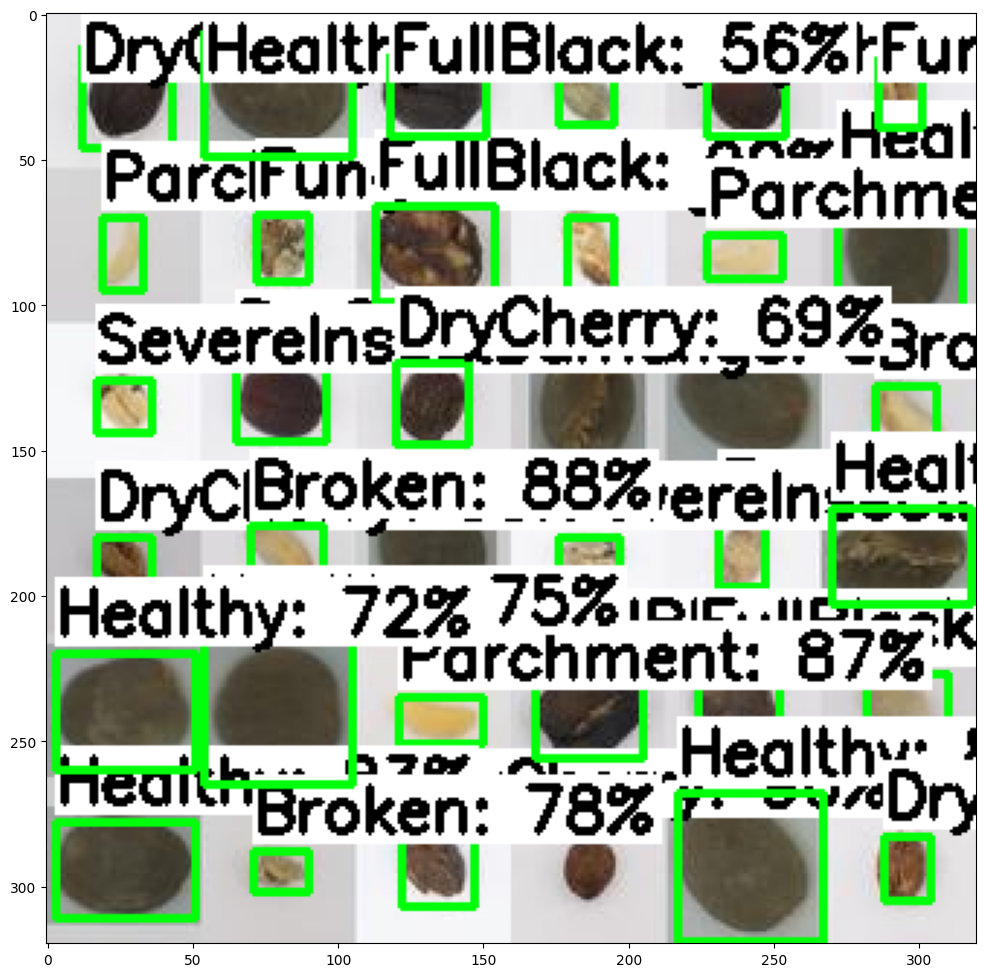

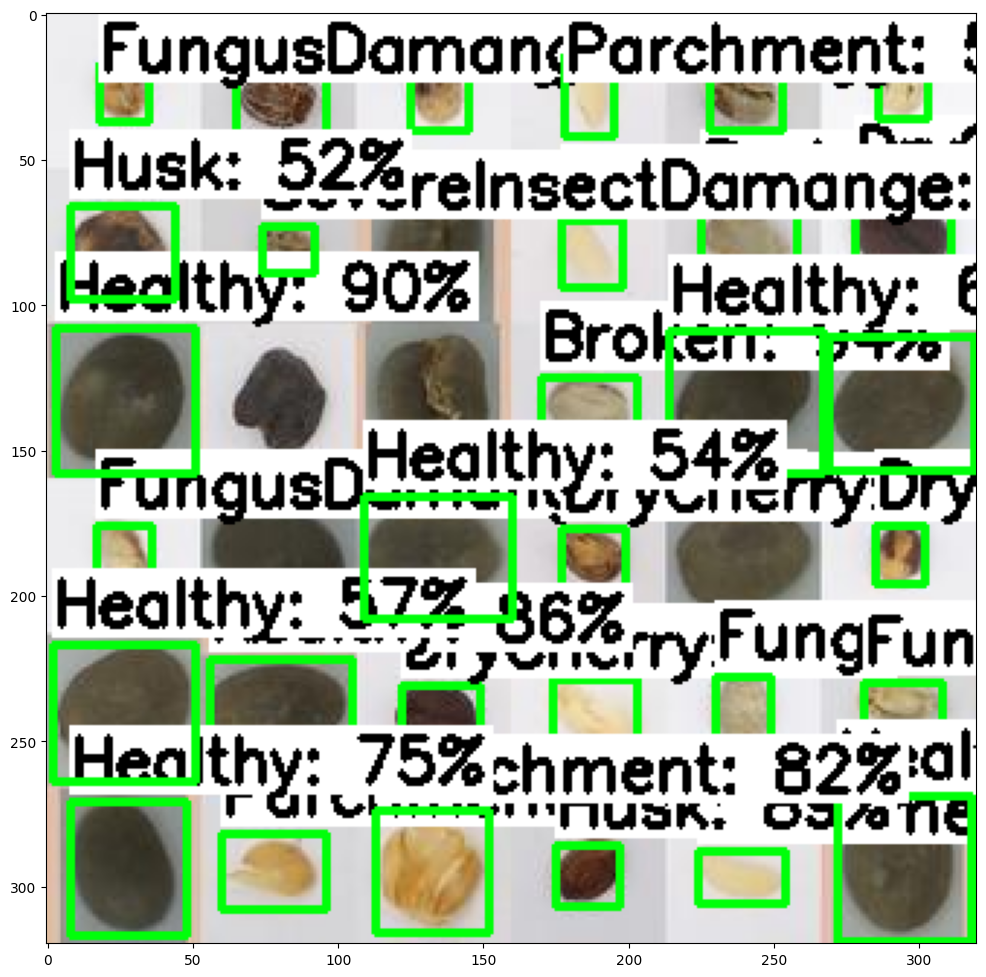

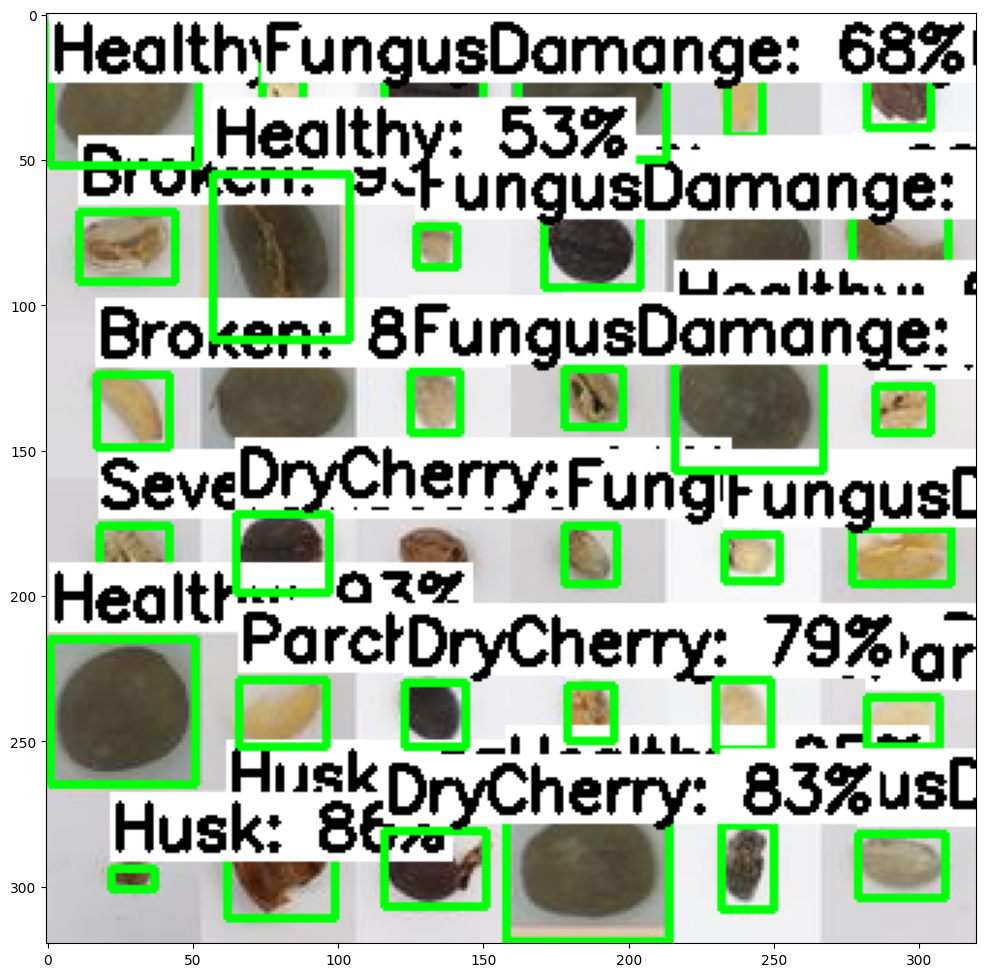

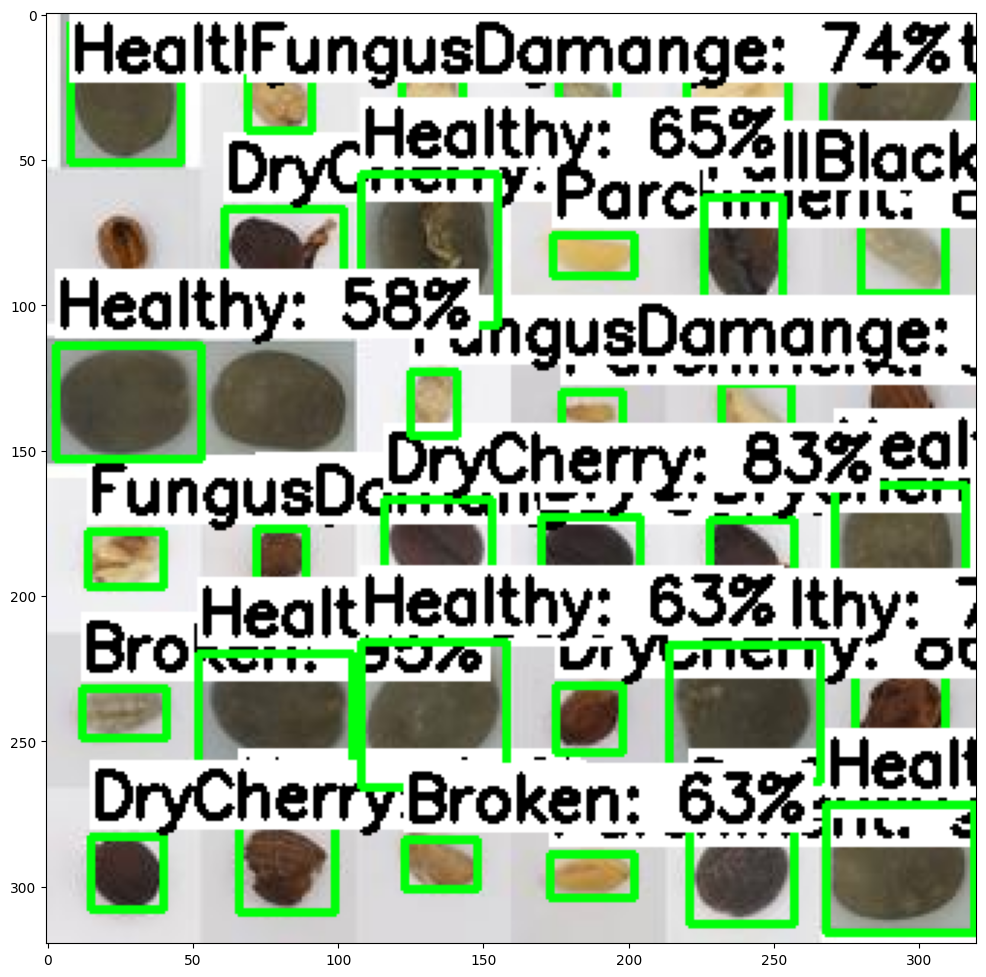

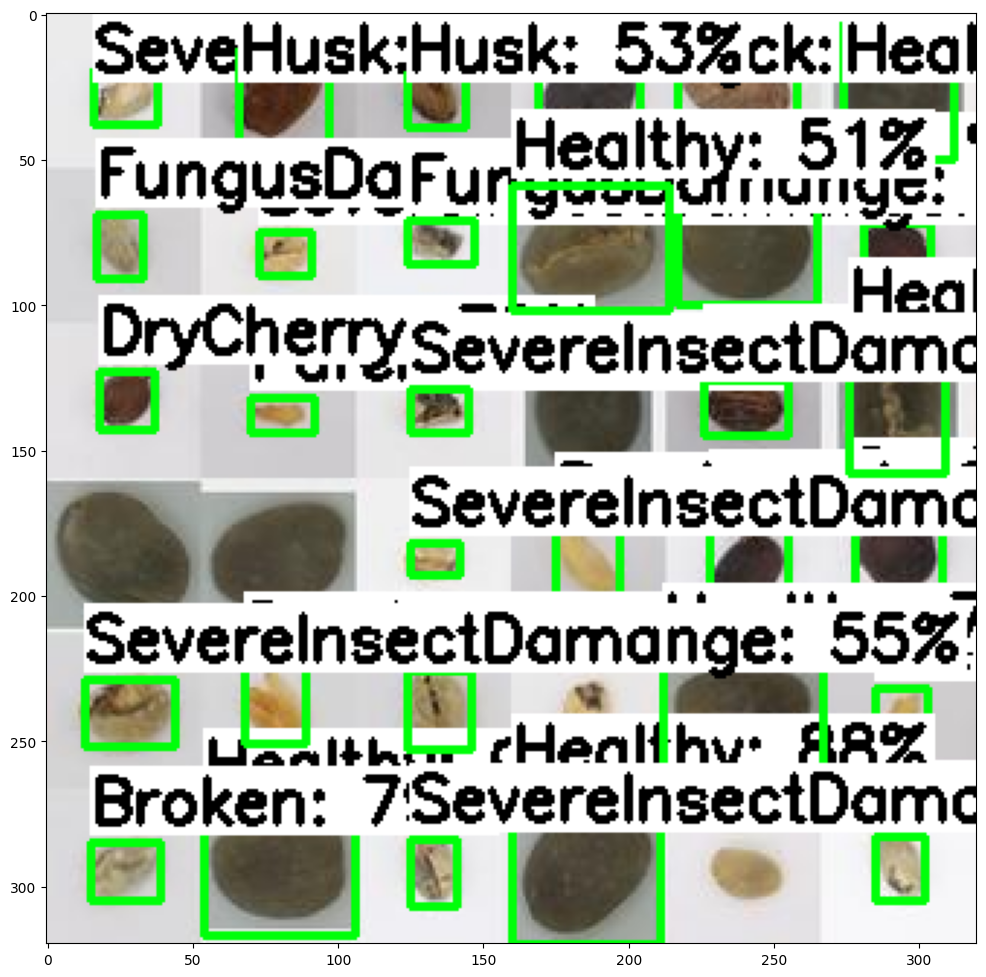

In [24]:
PATH_TO_IMAGES='/home/rafaella/mobilenetv2_projeto/models/inferencia2_mobile'   
PATH_TO_MODEL='/home/rafaella/mobilenetv2_projeto/custom_model_lite/detect.tflite'  
PATH_TO_LABELS='/home/rafaella/mobilenetv2_projeto/models/labelmap.txt'   
min_conf_threshold=0.5   
images_to_test = 5

tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

 
### 7.2 Calcular o mAP
Agora temos uma noção visual do desempenho do nosso modelo em imagens de teste, mas como podemos medir quantitativamente a sua precisão?
Um método popular para medir a precisão do modelo de deteção de objectos é a "precisão média média" (mAP). Basicamente, quanto maior for a pontuação mAP, melhor é o seu modelo na deteção de objectos em imagens. Para saber mais sobre o mAP, leia este [artigo do Roboflow](https://blog.roboflow.com/mean-average-precision/).
Usaremos a ferramenta de calculadora mAP em https://github.com/Cartucho/mAP para determinar a pontuação mAP do nosso modelo. Primeiro, precisamos clonar o repositório e remover os dados de exemplo existentes. Também vamos descarregar um script que escrevi para fazer a interface com a calculadora.

 
 


In [4]:
%%bash
git clone https://github.com/Cartucho/mAP /home/rafaella/mobilenetv2_projeto/mAP
cd /home/rafaella/mobilenetv2_projeto/mAP
rm input/detection-results/*
rm input/ground-truth/*
rm input/images-optional/*
wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py

Cloning into '/home/rafaella/mobilenetv2_projeto/mAP'...


--2025-07-05 10:13:38--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolvendo raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Conectando-se a raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... conectado.
A requisição HTTP foi enviada, aguardando resposta... 200 OK
Tamanho: 5397 (5,3K) [text/plain]
Salvando em: ‘calculate_map_cartucho.py’

     0K .....                                                 100% 26,3M=0s

2025-07-05 10:13:38 (26,3 MB/s) - ‘calculate_map_cartucho.py’ salvo [5397/5397]



### Em seguida, vamos copiar as imagens e os dados de anotação da pasta **test** para as pastas apropriadas dentro do repositório clonado. Estes serão utilizados como "dados de verdade" com os quais os resultados de deteção do nosso modelo serão comparados.
 
 

In [27]:
!rm -r /home/rafaella/mobilenetv2_projeto/mAP/input/images-optional/*

rm: não foi possível remover '/home/rafaella/mobilenetv2_projeto/mAP/input/images-optional/*': Arquivo ou diretório inexistente


In [ ]:
!cp /content/images/valid/* /content/mAP/input/images-optional # Copy images and xml files
!mv /content/mAP/input/images-optional/*.xml /content/mAP/input/ground-truth/  # Move xml files to the appropriate folder

A ferramenta da calculadora espera dados de anotação num formato que é diferente do formato de ficheiro .xml do Pascal VOC que estamos a usar. Felizmente, ele fornece um script fácil, `convert_gt_xml.py`, para converter para o formato .txt esperado.

In [38]:
!rm -r /home/rafaella/mobilenetv2_projeto/mAP/input/ground-truth/*
!rm -r /home/rafaella/mobilenetv2_projeto/mAP/input/detection-results*

In [5]:
!python /home/rafaella/mobilenetv2_projeto/mAP/scripts/extra/convert_gt_xml.py

Conversion completed!


Muito bem, já configurámos os dados verdadeiros, mas agora precisamos de resultados de deteção reais do nosso modelo.Os resultados da deteção serão comparados com os dados da verdade terrestre para calcular a precisão do modelo no mAP.
A função de inferência que definimos no Passo 7.1 pode ser utilizada para gerar dados de deteção para todas as imagens na pasta **test**. Vamos utilizá-la da mesma forma que antes, exceto que desta vez vamos dizer-lhe para guardar os resultados da deteção na pasta `detection-results`.
Clique em Reproduzir para executar o seguinte bloco de código!

In [9]:
import glob
PATH_TO_IMAGES='/home/rafaella/mobilenetv2_projeto/models/images/validation'   
PATH_TO_MODEL='/home/rafaella/mobilenetv2_projeto/custom_model_lite/detect.tflite'  
PATH_TO_LABELS='//home/rafaella/mobilenetv2_projeto/models/labelmap.txt'  
PATH_TO_RESULTS='/home/rafaella/mobilenetv2_projeto/mAP/input/detection-results' 
min_conf_threshold=0.3  

image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(1042, len(image_list)) 

txt_only = True

print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

Starting inference on 90 images...


INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


Finished inferencing!



Finalmente, vamos calcular o mAP!
Um estilo popular para relatar o mAP é a métrica COCO para mAP @ 0,50:0,95. Basicamente, isso significa que o mAP é calculado em vários limites de IoU entre 0,50 e 0,95 e, em seguida, o resultado de cada limite é calculado como média para obter uma pontuação final de mAP. [Saiba mais aqui!](https://blog.roboflow.com/mean-average-precision/)
Escrevi um script para executar a ferramenta da calculadora em cada limiar de IoU, calcular a média dos resultados e apresentar a pontuação de precisão final. Ele informa o mAP para cada classe e o mAP geral. Clique em Reproduzir nos dois blocos a seguir para calcular o mAP!

 
 


In [10]:
%cd /home/rafaella/mobilenetv2_projeto/mAP

/home/rafaella/mobilenetv2_projeto/mAP


In [11]:
!python /home/rafaella/mobilenetv2_projeto/mAP/scripts/extra/intersect-gt-and-dr.py

total ground-truth files: 90
total detection-results files: 90

No backup required for /home/rafaella/mobilenetv2_projeto/mAP/input/ground-truth
No backup required for /home/rafaella/mobilenetv2_projeto/mAP/input/detection-results
total intersected files: 90
Intersection completed!


In [12]:
!rm -rf /home/rafaella/mobilenetv2_projeto/mAP/outputs/


In [13]:
!cd /home/rafaella/mobilenetv2_projeto/mAP
!python /home/rafaella/mobilenetv2_projeto/mAP/calculate_map_cartucho.py --labels=/home/rafaella/mobilenetv2_projeto/models/labelmap.txt --show_plots

Calculating mAP at 0.50 IoU threshold...
98.81% = Broken AP 
97.47% = DryCherry AP 
97.54% = FullBlack AP 
94.22% = FungusDamange AP 
99.71% = Healthy AP 
98.30% = Husk AP 
99.62% = Parchment AP 
97.12% = SevereInsectDamange AP 
mAP = 97.85%
Traceback (most recent call last):
  File "main_modified.py", line 792, in <module>
    draw_plot_func(
  File "main_modified.py", line 298, in draw_plot_func
    fig.canvas.set_window_title(window_title)
AttributeError: 'FigureCanvasAgg' object has no attribute 'set_window_title'
Calculating mAP at 0.55 IoU threshold...
98.30% = Broken AP 
97.47% = DryCherry AP 
97.54% = FullBlack AP 
94.22% = FungusDamange AP 
99.71% = Healthy AP 
98.30% = Husk AP 
97.69% = Parchment AP 
96.86% = SevereInsectDamange AP 
mAP = 97.51%
Traceback (most recent call last):
  File "main_modified.py", line 792, in <module>
    draw_plot_func(
  File "main_modified.py", line 298, in draw_plot_func
    fig.canvas.set_window_title(window_title)
AttributeError: 'FigureCanvas

## Curva de precisão e recall


IoU - 0.5

In [14]:
# AP and precision/recall per class
#98.81% = Broken AP 
Precision_Broken= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.98', '0.98', '0.98']
Recall_Broken= ['0.00', '0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.97', '0.98', '0.98', '0.98', '0.98', '0.98', '0.99', '0.99', '0.99', '0.99']

#97.47% = DryCherry AP 
Precision_DryCherry= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.97']
Recall_DryCherry= ['0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.97', '0.98', '0.98', '0.98', '0.98']

#97.54% = FullBlack AP 
Precision_FullBlack=['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00']
Recall_FullBlack= ['0.00', '0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.98']

#94.22% = FungusDamange AP 
Precision_FungusDamange= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97']
Recall_FungusDamange= ['0.00', '0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95']

#99.71% = Healthy AP 
Precision_Healthy= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00']
Recall_Healthy= ['0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.98', '0.98', '0.98', '0.98', '0.99', '0.99', '0.99', '0.99', '1.00']

#98.30% = Husk AP 
Precision_Husk= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.96', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.96', '0.96']
Recall_Husk= ['0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.97', '0.98', '0.98', '0.98', '0.98', '0.99', '0.99', '0.99']

#99.62% = Parchment AP 
Precision_Parchment= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99']
Recall_Parchment= ['0.00', '0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.97', '0.98', '0.98', '0.98', '0.98', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00']

#97.12% = SevereInsectDamange AP 
Precision_SevereInsectDamange= ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.98', '0.97', '0.98', '0.97', '0.97']
Recall_SevereInsectDamange= ['0.00', '0.00', '0.01', '0.01', '0.01', '0.01', '0.02', '0.02', '0.02', '0.02', '0.03', '0.03', '0.03', '0.03', '0.04', '0.04', '0.04', '0.04', '0.05', '0.05', '0.05', '0.05', '0.06', '0.06', '0.06', '0.06', '0.07', '0.07', '0.07', '0.07', '0.08', '0.08', '0.08', '0.08', '0.09', '0.09', '0.09', '0.09', '0.10', '0.10', '0.10', '0.10', '0.11', '0.11', '0.11', '0.11', '0.12', '0.12', '0.12', '0.12', '0.13', '0.13', '0.13', '0.13', '0.14', '0.14', '0.14', '0.14', '0.15', '0.15', '0.15', '0.15', '0.16', '0.16', '0.16', '0.16', '0.17', '0.17', '0.17', '0.17', '0.18', '0.18', '0.18', '0.18', '0.19', '0.19', '0.19', '0.19', '0.20', '0.20', '0.20', '0.20', '0.21', '0.21', '0.21', '0.21', '0.22', '0.22', '0.22', '0.22', '0.23', '0.23', '0.23', '0.23', '0.24', '0.24', '0.24', '0.24', '0.25', '0.25', '0.25', '0.25', '0.26', '0.26', '0.26', '0.26', '0.27', '0.27', '0.27', '0.27', '0.28', '0.28', '0.28', '0.28', '0.29', '0.29', '0.29', '0.29', '0.30', '0.30', '0.30', '0.30', '0.31', '0.31', '0.31', '0.31', '0.32', '0.32', '0.32', '0.32', '0.33', '0.33', '0.33', '0.33', '0.34', '0.34', '0.34', '0.34', '0.35', '0.35', '0.35', '0.35', '0.36', '0.36', '0.36', '0.36', '0.37', '0.37', '0.37', '0.37', '0.38', '0.38', '0.38', '0.38', '0.39', '0.39', '0.39', '0.39', '0.40', '0.40', '0.40', '0.40', '0.41', '0.41', '0.41', '0.41', '0.42', '0.42', '0.42', '0.42', '0.43', '0.43', '0.43', '0.43', '0.44', '0.44', '0.44', '0.44', '0.45', '0.45', '0.45', '0.45', '0.46', '0.46', '0.46', '0.46', '0.47', '0.47', '0.47', '0.47', '0.48', '0.48', '0.48', '0.48', '0.49', '0.49', '0.49', '0.49', '0.50', '0.50', '0.50', '0.50', '0.50', '0.51', '0.51', '0.51', '0.51', '0.52', '0.52', '0.52', '0.52', '0.53', '0.53', '0.53', '0.53', '0.54', '0.54', '0.54', '0.54', '0.55', '0.55', '0.55', '0.55', '0.56', '0.56', '0.56', '0.56', '0.57', '0.57', '0.57', '0.57', '0.58', '0.58', '0.58', '0.58', '0.59', '0.59', '0.59', '0.59', '0.60', '0.60', '0.60', '0.60', '0.61', '0.61', '0.61', '0.61', '0.62', '0.62', '0.62', '0.62', '0.63', '0.63', '0.63', '0.63', '0.64', '0.64', '0.64', '0.64', '0.65', '0.65', '0.65', '0.65', '0.65', '0.66', '0.66', '0.66', '0.66', '0.67', '0.67', '0.67', '0.67', '0.68', '0.68', '0.68', '0.68', '0.69', '0.69', '0.69', '0.69', '0.70', '0.70', '0.70', '0.70', '0.70', '0.71', '0.71', '0.71', '0.71', '0.72', '0.72', '0.72', '0.72', '0.73', '0.73', '0.73', '0.73', '0.74', '0.74', '0.74', '0.74', '0.75', '0.75', '0.75', '0.75', '0.76', '0.76', '0.76', '0.76', '0.77', '0.77', '0.77', '0.77', '0.78', '0.78', '0.78', '0.78', '0.79', '0.79', '0.79', '0.79', '0.80', '0.80', '0.80', '0.80', '0.80', '0.81', '0.81', '0.81', '0.81', '0.82', '0.82', '0.82', '0.82', '0.83', '0.83', '0.83', '0.83', '0.84', '0.84', '0.84', '0.84', '0.84', '0.85', '0.85', '0.85', '0.85', '0.85', '0.85', '0.86', '0.86', '0.86', '0.86', '0.87', '0.87', '0.87', '0.87', '0.88', '0.88', '0.88', '0.88', '0.89', '0.89', '0.89', '0.89', '0.89', '0.89', '0.90', '0.90', '0.90', '0.90', '0.90', '0.91', '0.91', '0.91', '0.91', '0.92', '0.92', '0.92', '0.92', '0.93', '0.93', '0.93', '0.93', '0.94', '0.94', '0.94', '0.94', '0.95', '0.95', '0.95', '0.95', '0.96', '0.96', '0.96', '0.96', '0.97', '0.97', '0.97', '0.97', '0.97', '0.97', '0.98']




In [15]:
Precision_Broken = [float(x) for x in Precision_Broken]
Recall_Broken = [float(x) for x in Recall_Broken]

Precision_DryCherry = [float(x) for x in Precision_DryCherry]
Recall_DryCherry = [float(x) for x in Recall_DryCherry]

Precision_FullBlack = [float(x) for x in Precision_FullBlack]
Recall_FullBlack =[float(x) for x in Recall_FullBlack]

Precision_FungusDamange =[float(x) for x in Precision_FungusDamange]
Recall_FungusDamange = [float(x) for x in Recall_FungusDamange]

Precision_Healthy = [float(x) for x in Precision_Healthy]
Recall_Healthy = [float(x) for x in Recall_Healthy]

Precision_Husk = [float(x) for x in Precision_Husk]
Recall_Husk = [float(x) for x in Recall_Husk]

Precision_Parchment = [float(x) for x in Precision_Parchment]
Recall_Parchment = [float(x) for x in Recall_Parchment]

Precision_SevereInsectDamange = [float(x) for x in Precision_SevereInsectDamange]
Recall_SevereInsectDamange = [float(x) for x in Recall_SevereInsectDamange]



In [16]:
precision_sum = [sum(x) for x in zip(Precision_Broken, Precision_DryCherry, Precision_FullBlack, Precision_FungusDamange, Precision_Healthy, Precision_Husk, Precision_Parchment, Precision_SevereInsectDamange)]
recall_sum = [sum(x) for x in zip(Recall_Broken, Recall_DryCherry, Recall_FullBlack, Recall_FungusDamange, Recall_Healthy, Recall_Husk, Recall_Parchment, Recall_SevereInsectDamange)]

Precision_all_classes = [x / 10 for x in precision_sum]
Recall_all_classes = [x / 10 for x in recall_sum]

print("Média de Precisão:", Precision_all_classes)
print("Média de Recall:", Recall_all_classes)


Média de Precisão: [0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.8, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.798, 0.79

## F1-SCORE e Recall para IoU 0.5

In [17]:
recall_mean = sum(Recall_all_classes) / len(Recall_all_classes)
# Imprima os resultados
print("Recall médio:", recall_mean)


Recall médio: 0.3884619289340103


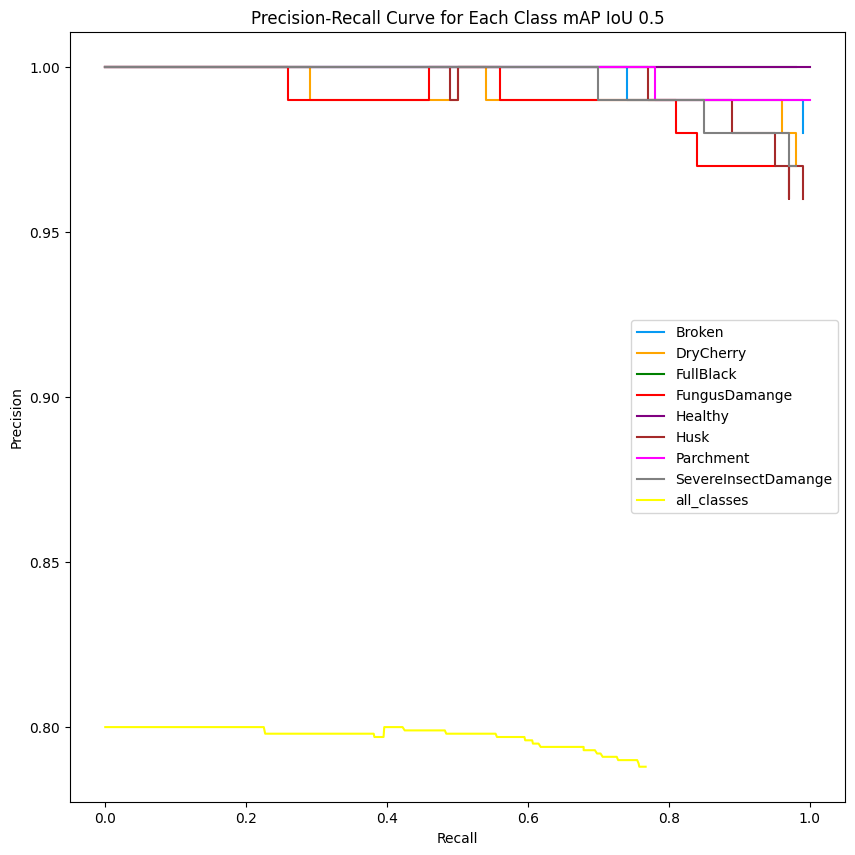

In [18]:
import matplotlib.pyplot as plt

map_values = ['0.99','0.97','0.98','0.94','0.99','0.98', '0.99','0.97','0.97 mAP:0.5']
class_names = ['Broken', 'DryCherry', 'FullBlack', 'FungusDamange', 'Healthy', 'Husk', 'Parchment', 'SevereInsectDamange', 'all_classes']
colors = ['#069af3', 'orange', 'green', 'red', 'purple', 'brown', 'fuchsia', 'grey', 'yellow', 'cyan']

fig, ax = plt.subplots(figsize=(10, 10))

for i, class_name in enumerate(class_names):
    ax.plot(eval(f'Recall_{class_name}'), eval(f'Precision_{class_name}'), color=colors[i], label=class_name)

ax.set_title('Precision-Recall Curve for Each Class mAP IoU 0.5')
ax.set_xlabel('Recall')
ax.set_ylabel('Precision')

ax.legend()
plt.show()


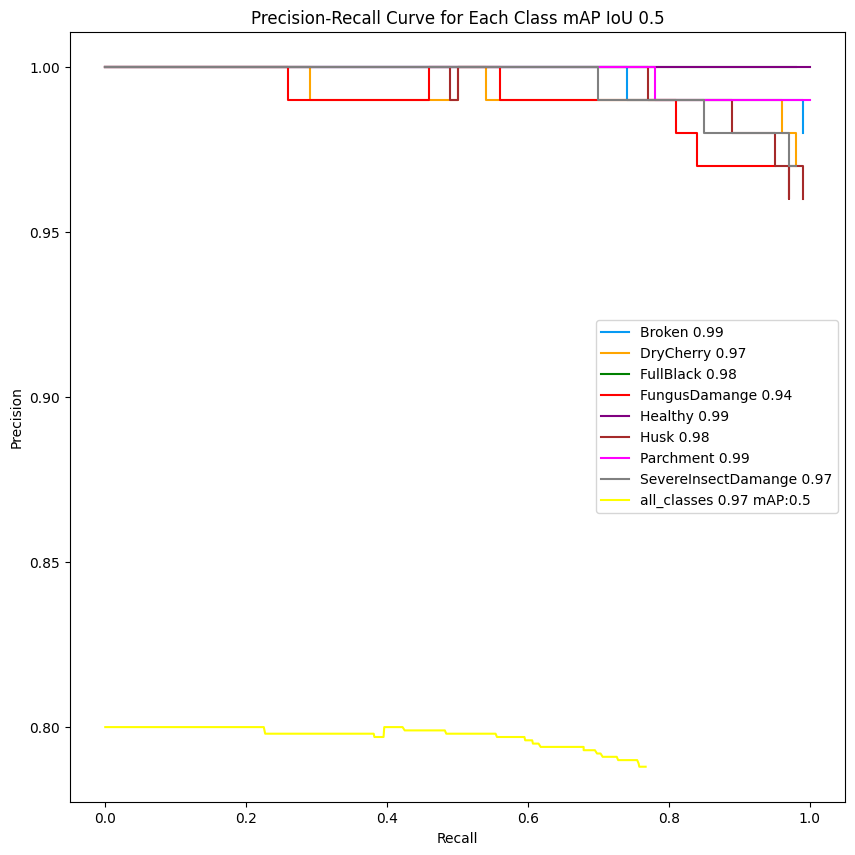

In [19]:
map_values = ['0.99','0.97','0.98','0.94','0.99','0.98', '0.99','0.97','0.97 mAP:0.5']
class_names = ['Broken', 'DryCherry', 'FullBlack', 'FungusDamange', 'Healthy', 'Husk', 'Parchment', 'SevereInsectDamange', 'all_classes']
colors = ['#069af3', 'orange', 'green', 'red', 'purple', 'brown', 'fuchsia', 'grey', 'yellow', 'cyan']

fig, ax = plt.subplots(figsize=(10, 10))

for i, class_name in enumerate(class_names):
    ax.plot(eval(f'Recall_{class_name}'), eval(f'Precision_{class_name}'), color=colors[i], label=f'{class_name} {map_values[i]}')
ax.set_title('Precision-Recall Curve for Each Class mAP IoU 0.5')
ax.set_xlabel('Recall')
ax.set_ylabel('Precision')

# Add the legend
ax.legend()
# Display the plot
plt.show()


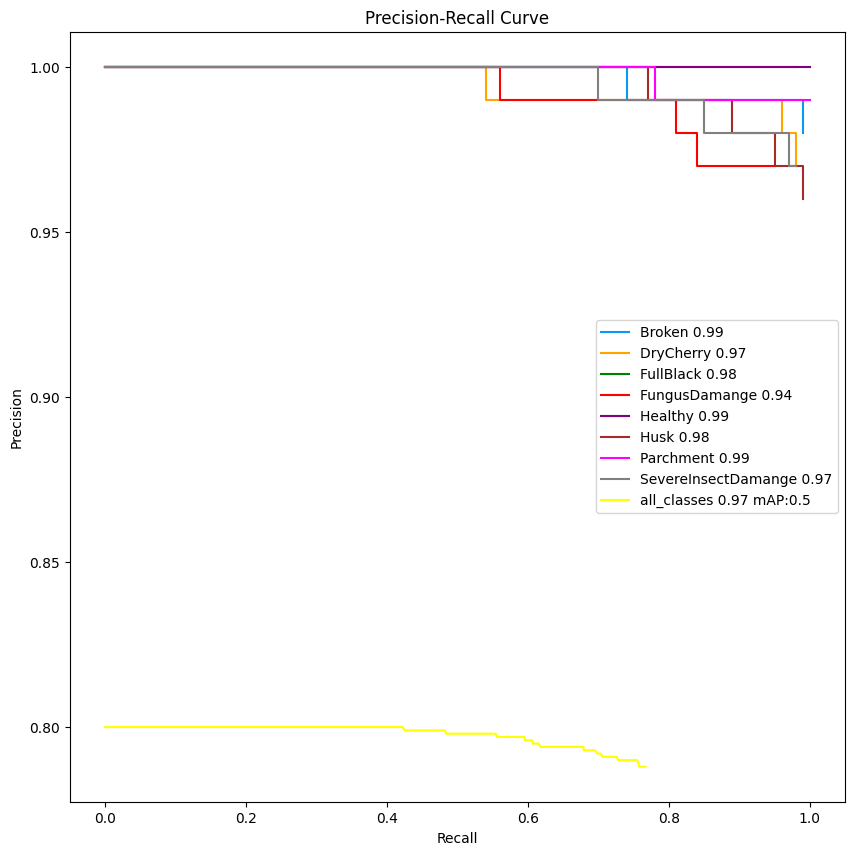

In [20]:
interpolated_precision = []
for i in range(len(class_names)):
    precision = eval(f'Precision_{class_names[i]}')
    recall = eval(f'Recall_{class_names[i]}')

    interpolated_precision.append([max(precision[j:]) for j in range(len(recall))])

fig, ax = plt.subplots(figsize=(10, 10))

for i, class_name in enumerate(class_names):
    ax.plot(eval(f'Recall_{class_name}'), interpolated_precision[i], color=colors[i], label=f'{class_name} {map_values[i]}')

ax.set_title('Precision-Recall Curve')
ax.set_xlabel('Recall')
ax.set_ylabel('Precision')

ax.legend()
plt.show()


# Matriz de confusão

In [25]:
!rm -rf /content/mAP/input/ground-truth/backup/

In [23]:
!pip install seaborn

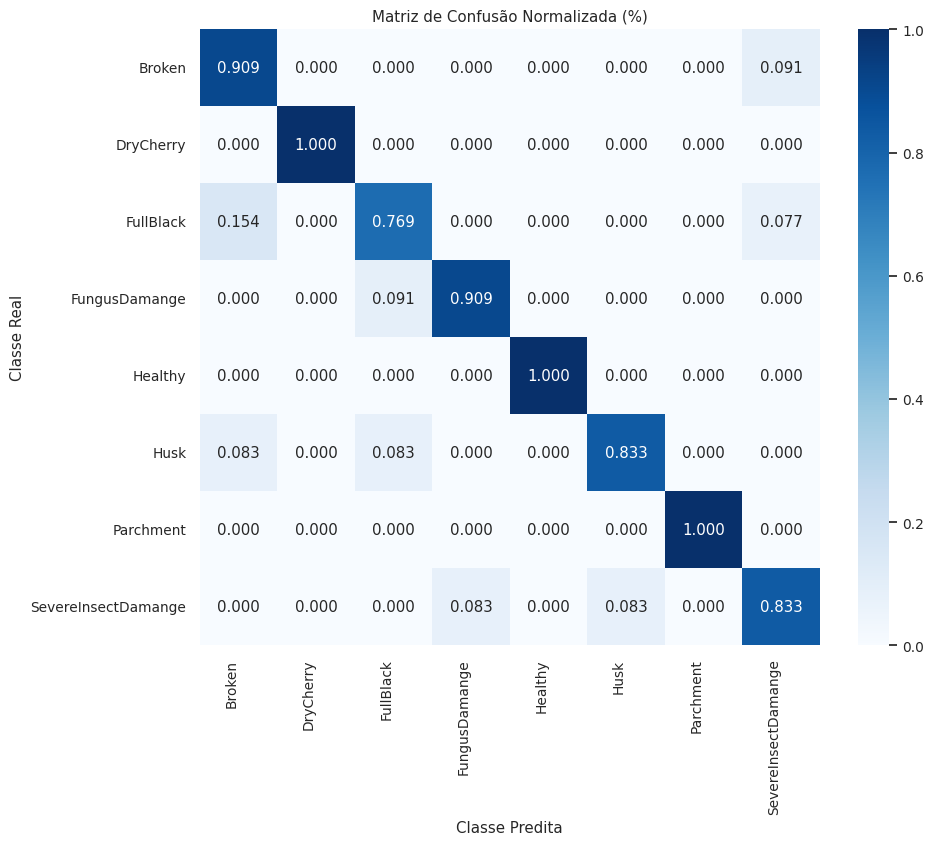

In [27]:
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

class_mapping = {
    "Broken": 1,
    "DryCherry": 2,
    "FullBlack": 3,
    "FungusDamange": 4,
    "Healthy": 5,
    "Husk": 6,
    "Parchment": 7,
    "SevereInsectDamange": 8

}

def read_files(prediction_dir, ground_truth_dir):
    predictions = []
    ground_truth = []

    for file in os.listdir(prediction_dir):
        with open(os.path.join(prediction_dir, file), 'r') as f:
            prediction = f.readline().strip().split()
            if prediction:
                class_name = prediction[0]
                class_index = class_mapping.get(class_name, 0) 
                predictions.append(class_index)
            else:
                predictions.append(0)  

    for file in os.listdir(ground_truth_dir):
        with open(os.path.join(ground_truth_dir, file), 'r') as f:
            ground_truth_label = f.readline().strip().split()[0]
            ground_truth_index = class_mapping.get(ground_truth_label, 0)  
            ground_truth.append(ground_truth_index)

    return predictions, ground_truth

prediction_dir = "/home/rafaella/mobilenetv2_projeto/mAP/input/detection-results"
ground_truth_dir = "/home/rafaella/mobilenetv2_projeto/mAP/input/ground-truth"

predictions, ground_truth = read_files(prediction_dir, ground_truth_dir)

conf_matrix = confusion_matrix(ground_truth, predictions)

row_sums = conf_matrix.sum(axis=1, keepdims=True)
conf_matrix_normalized = np.where(row_sums != 0, conf_matrix / row_sums, 0)

class_labels = list(class_mapping.keys())

plt.figure(figsize=(10, 8))
sns.set(font_scale=0.9)
ax = sns.heatmap(conf_matrix_normalized, fmt='.3f', annot=True, cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.title("Matriz de Confusão Normalizada (%)")
plt.xlabel("Classe Predita")
plt.ylabel("Classe Real")
plt.xticks(rotation=90, ha='right')
plt.yticks(rotation=0)
plt.show()


A pontuação indicada no final é a pontuação global do mAP do seu modelo. Idealmente, deve ser superior a 50% (0,50).

# 8.&nbsp;Implantar o modelo TensorFlow Lite

 
 


Agora que seu modelo personalizado foi treinado e convertido para o formato TFLite, ele está pronto para ser baixado e implantado em um aplicativo! Esta secção mostra como descarregar o modelo e fornece ligações para instruções para o implementar no Raspberry Pi, no seu PC ou noutros dispositivos periféricos.

## 8.1. Descarregar o modelo TFLite
Execute as duas células seguintes para copiar os ficheiros labelmap para a pasta do modelo, comprima-a numa pasta zip e depois descarregue-a. A pasta zip contém o modelo `detect.tflite` e os ficheiros de mapa de etiquetas `labelmap.txt` que são necessários para executar o modelo na sua aplicação.

In [ ]:

!cp /content/labelmap.txt /content/custom_model_lite
!cp /content/labelmap.pbtxt /content/custom_model_lite
!cp /content/models/mymodel/pipeline_file.config /content/custom_model_lite

%cd /content
!zip -r custom_model_lite.zip custom_model_lite

/content
  adding: custom_model_lite/ (stored 0%)
  adding: custom_model_lite/detect.tflite (deflated 9%)
  adding: custom_model_lite/labelmap.pbtxt (deflated 61%)
  adding: custom_model_lite/pipeline_file.config (deflated 65%)
  adding: custom_model_lite/saved_model/ (stored 0%)
  adding: custom_model_lite/saved_model/saved_model.pb (deflated 91%)
  adding: custom_model_lite/saved_model/assets/ (stored 0%)
  adding: custom_model_lite/saved_model/variables/ (stored 0%)
  adding: custom_model_lite/saved_model/variables/variables.data-00000-of-00001 (deflated 9%)
  adding: custom_model_lite/saved_model/variables/variables.index (deflated 78%)
  adding: custom_model_lite/labelmap.txt (deflated 20%)


In [ ]:
from google.colab import files

files.download('/content/custom_model_lite.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

O ficheiro `custom_model_lite.zip` que contém o modelo será transferido para a sua pasta Downloads. Ele está pronto para ser implantado no seu dispositivo!


## 8.2. Implantar modelo
Os modelos do TensorFlow Lite podem ser executados em uma ampla variedade de hardware, incluindo PCs, sistemas incorporados e telefones. Esta secção fornece instruções que mostram como implementar o seu modelo TFLite em vários dispositivos.
### 8.2.1. Implantar no Raspberry Pi
Os modelos TFLite são ótimos para serem executados no Raspberry Pi, porque eles exigem menos poder de processamento do que os modelos de visão TensorFlow regulares. O Pi pode executar modelos TFLite quase em tempo real.
Para executar o seu novo modelo no Raspberry Pi, terá de instalar o TensorFlow Lite e preparar um ambiente Python para a sua aplicação. Forneço instruções passo a passo sobre como configurar o TFLite no Pi no meu vídeo, [How To Run TensorFlow Lite on Raspberry Pi for Object Detection](https://youtu.be/aimSGOAUI8Y).
[![Link para o meu vídeo do YouTube!](https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/doc/YouTube_video1.JPG)](https://www.youtube.com/watch?v=aimSGOAUI8Y)
Depois de concluir todas as etapas do vídeo, mova o arquivo `custom_model_lite.zip` baixado desta sessão do Colab para o seu Raspberry Pi na pasta `~/tflite1`. Vá para a pasta e descompacte-o emitindo:
```
cd ~/tflite1
descompactar custom_model_lite.zip
```
Em seguida, execute o programa de deteção de imagem, vídeo ou webcam do TFLite com o argumento `--modeldir=fine_tuned_model_lite`. Por exemplo, para executar o programa de deteção de webcam, digite:
```
python TFLite_detection_webcam.py --modeldir=custom_model_lite
```
Aparecerá uma janela que mostra uma transmissão em direto da sua webcam com caixas desenhadas à volta dos objectos detectados em cada fotograma.
### 8.2.2. Implantar no Windows, Linux ou macOS
Siga as instruções abaixo para configurar rapidamente seu computador Windows, Linux ou macOS para executar modelos TFLite. Leva apenas alguns minutos! Executar um modelo no seu PC é bom para testar rapidamente seu modelo com uma webcam. No entanto, lembre-se de que o tempo de execução do TFLite é otimizado para processadores de baixa potência e não utilizará toda a capacidade do processador do seu PC.
Aqui estão os links para os guias de implantação para Windows, Linux e macOS:
* [Como executar modelos do TensorFlow Lite no Windows] (https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/deploy_guides/Windows_TFLite_Guide.md)
* *link para o guia do Linux a ser adicionado (mas na verdade é o mesmo do Raspberry Pi)*
* [Como executar modelos do TensorFlow Lite no macOS](https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/deploy_guides/MacOS_TFLite_Guide.md)




# 9.&nbsp;(opicional) Quantização

Quer fazer o seu modelo TFLite funcionar ainda mais rápido? Quantize-o! A quantização de um modelo converte seus pesos de valores de ponto flutuante de 32 bits para valores inteiros de 8 bits. Isso permite que o modelo quantizado seja executado mais rapidamente e ocupe menos memória sem reduzir muito a precisão.
> Nota: Se observar uma diminuição óbvia na precisão da deteção ao quantizar o seu modelo com o TF2, recomendo que utilize o TensorFlow 1 para quantizar o seu modelo. O TF1 suporta treinamento com reconhecimento de quantização, o que ajuda a melhorar a precisão dos modelos quantizados. O modelo ssd-mobilenet-v2-quantizado do TF1 Model Zoo tem desempenho rápido e preciso quando treinado com um conjunto de dados personalizado. Visite o meu [TFLite v1 Colab notebook](https://colab.research.google.com/github/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/Train_TFLite1_Object_Detection_Model.ipynb) para obter instruções passo a passo sobre como treinar e quantizar um modelo com o TensorFlow 1.

## 9.1. Quantizar o modelo
Usaremos o módulo "TFLiteConverter" para realizar a [quantização pós-treinamento](https://www.tensorflow.org/lite/performance/post_training_quantization) no modelo. Para quantificar o modelo, precisamos fornecer um conjunto de dados representativo, que é um conjunto de imagens que representam o que o modelo verá quando implantado no campo. Primeiro, criaremos uma lista de imagens para incluir no conjunto de dados representativo (usaremos apenas as imagens na pasta `train`).


 
 


In [ ]:

image_path = '/content/images/train'

jpg_file_list = glob.glob(image_path + '/*.jpg')
JPG_file_list = glob.glob(image_path + '/*.JPG')
png_file_list = glob.glob(image_path + '/*.png')
bmp_file_list = glob.glob(image_path + '/*.bmp')

quant_image_list = jpg_file_list + JPG_file_list + png_file_list + bmp_file_list

Em seguida, vamos definir uma função para produzir imagens do nosso conjunto de dados representativo. Consulte o [código de quantização de exemplo do TensorFlow](https://colab.research.google.com/github/google-coral/tutorials/blob/master/retrain_classification_ptq_tf2.ipynb#scrollTo=kRDabW_u1wnv) para compreender melhor o que isto está a fazer!

 
 


In [ ]:
# A generator that provides a representative dataset
# Code modified from https://colab.research.google.com/github/google-coral/tutorials/blob/master/retrain_classification_ptq_tf2.ipynb

# First, get input details for model so we know how to preprocess images
interpreter = Interpreter(model_path=PATH_TO_MODEL) # PATH_TO_MODEL is defined in Step 7 above
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()
height = input_details[0]['shape'][1]
width = input_details[0]['shape'][2]

import random

def representative_data_gen():
  dataset_list = quant_image_list
  quant_num = 300
  for i in range(quant_num):
    pick_me = random.choice(dataset_list)
    image = tf.io.read_file(pick_me)

    if pick_me.endswith('.jpg') or pick_me.endswith('.JPG'):
      image = tf.io.decode_jpeg(image, channels=3)
    elif pick_me.endswith('.png'):
      image = tf.io.decode_png(image, channels=3)
    elif pick_me.endswith('.bmp'):
      image = tf.io.decode_bmp(image, channels=3)

    image = tf.image.resize(image, [width, height])  # TO DO: Replace 300s with an automatic way of reading network input size
    image = tf.cast(image / 255., tf.float32)
    image = tf.expand_dims(image, 0)
    yield [image]

Finalmente, vamos inicializar o módulo TFLiteConverter, apontá-lo para o gráfico TFLite que geramos na Etapa 6 e fornecer a ele a função geradora de conjunto de dados representativos que criamos no bloco de código anterior. Configuraremos o conversor para quantizar os valores de peso do modelo no formato INT8.

 
 


In [ ]:

converter = tf.lite.TFLiteConverter.from_saved_model('/content/custom_model_lite/saved_model')

converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.representative_dataset = representative_data_gen
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS, tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
converter.target_spec.supported_types = [tf.int8]
converter.inference_input_type = tf.uint8
converter.inference_output_type = tf.float32
tflite_model = converter.convert()

with open('/content/custom_model_lite/detect_quant.tflite', 'wb') as f:
  f.write(tflite_model)

## 9.2. Testar modelo quantizado
O modelo foi quantizado e exportado como `detect_quant.tflite`. Vamos testá-lo! Vamos reutilizar a função da Secção 7 para executar o modelo em imagens de teste e mostrar os resultados, só que desta vez vamos apontá-la para o modelo quantizado.
Clique em Reproduzir no bloco de código abaixo para testar o modelo `detect_quant.tflite`.

 
 


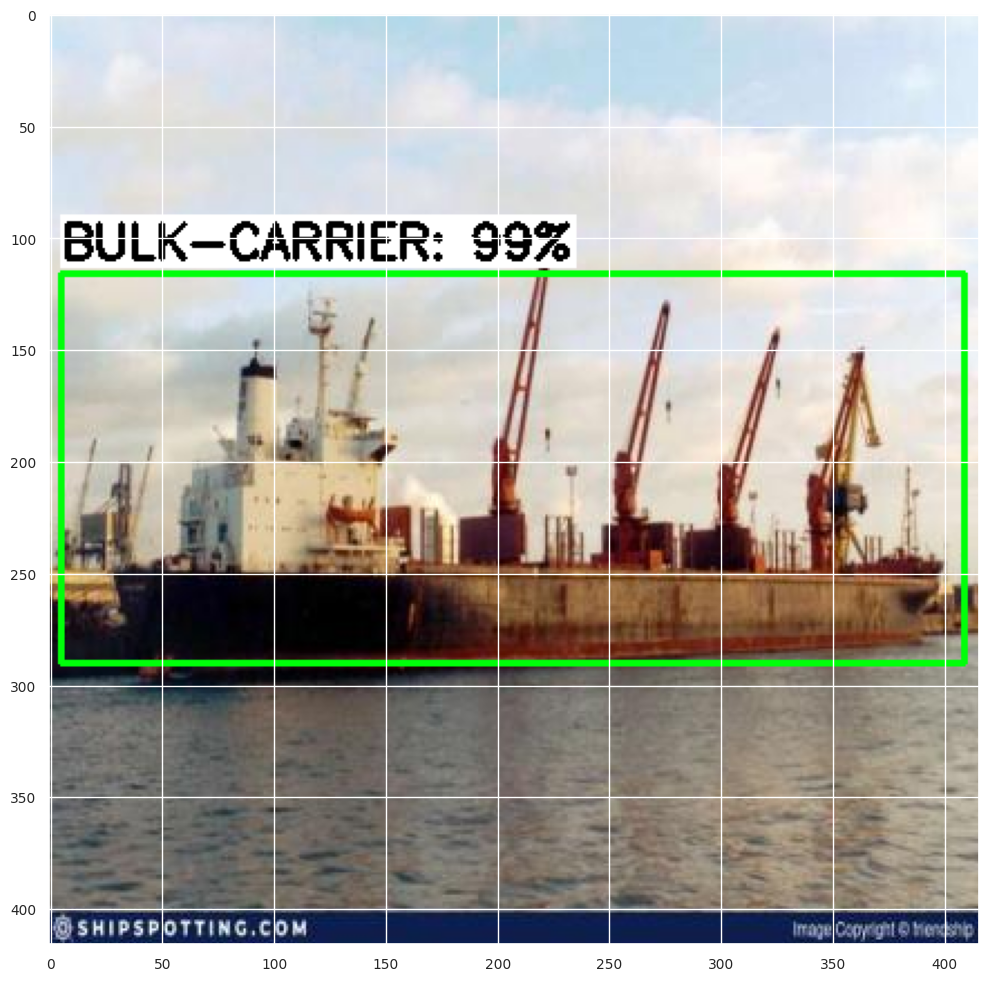

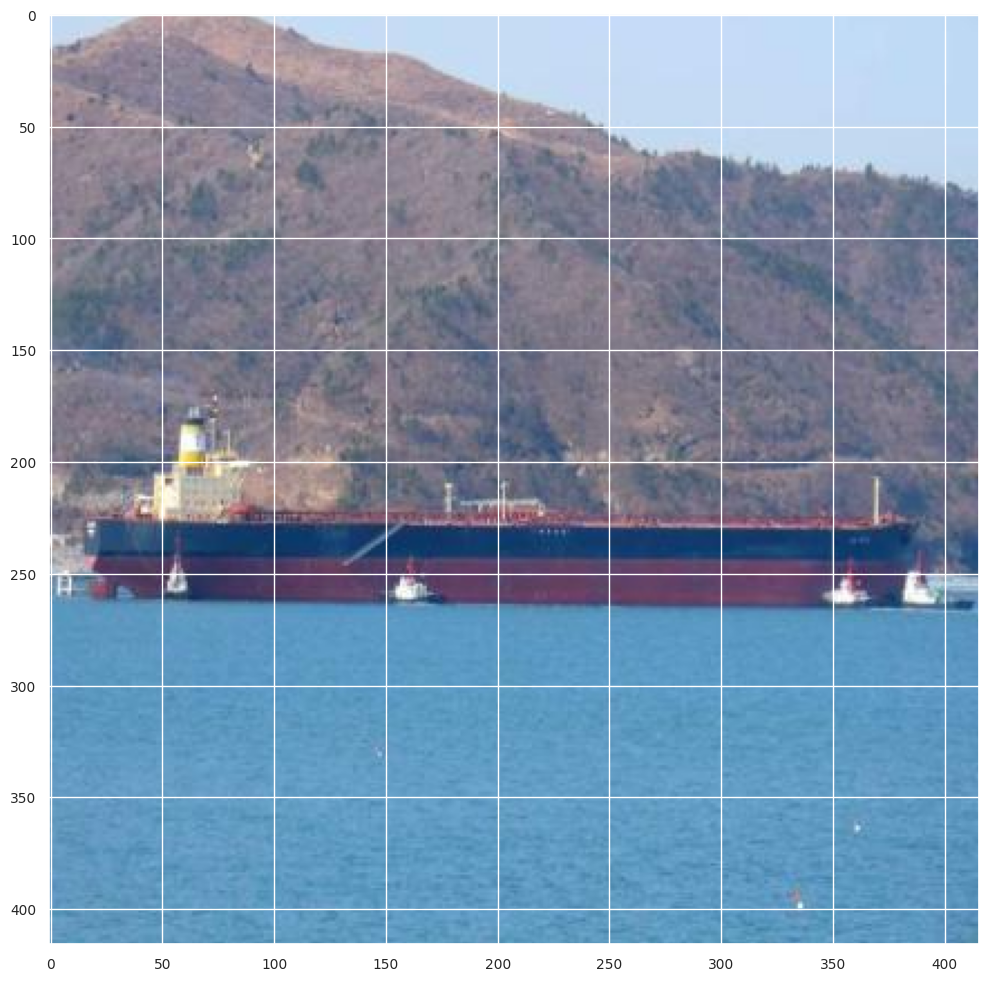

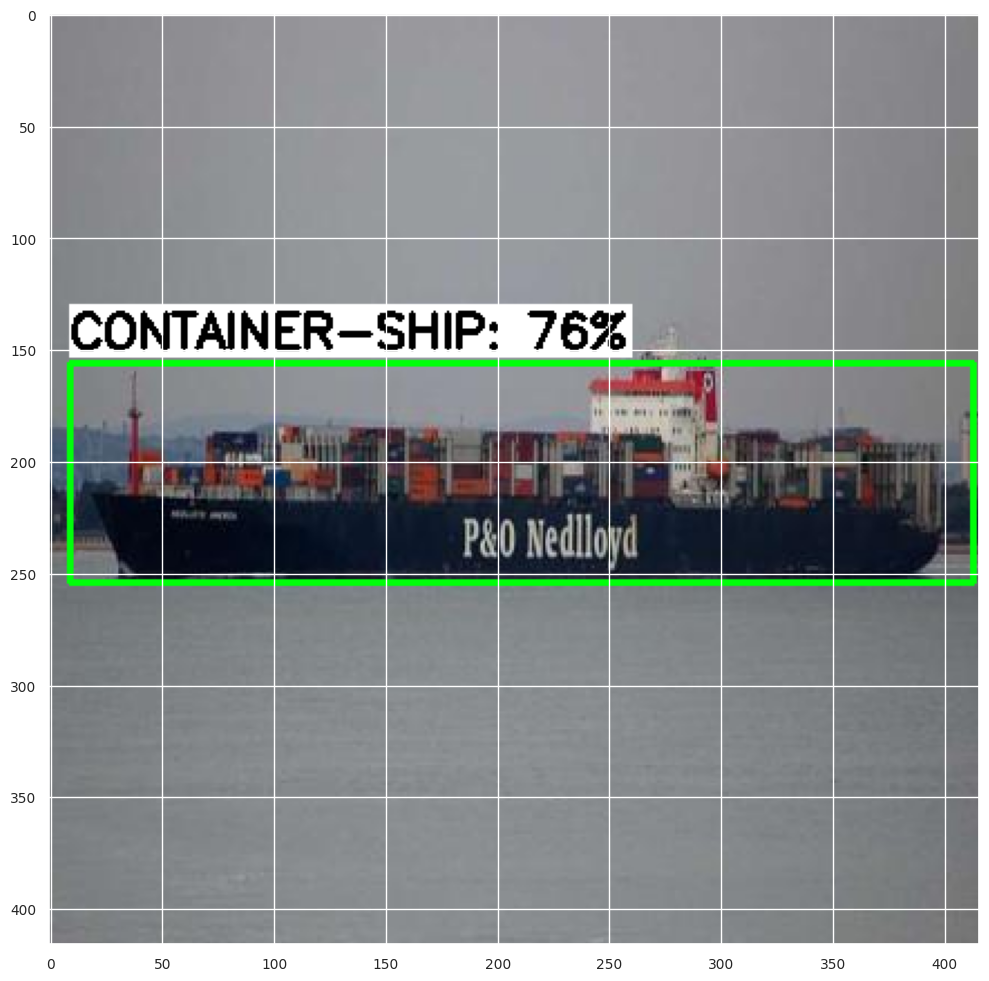

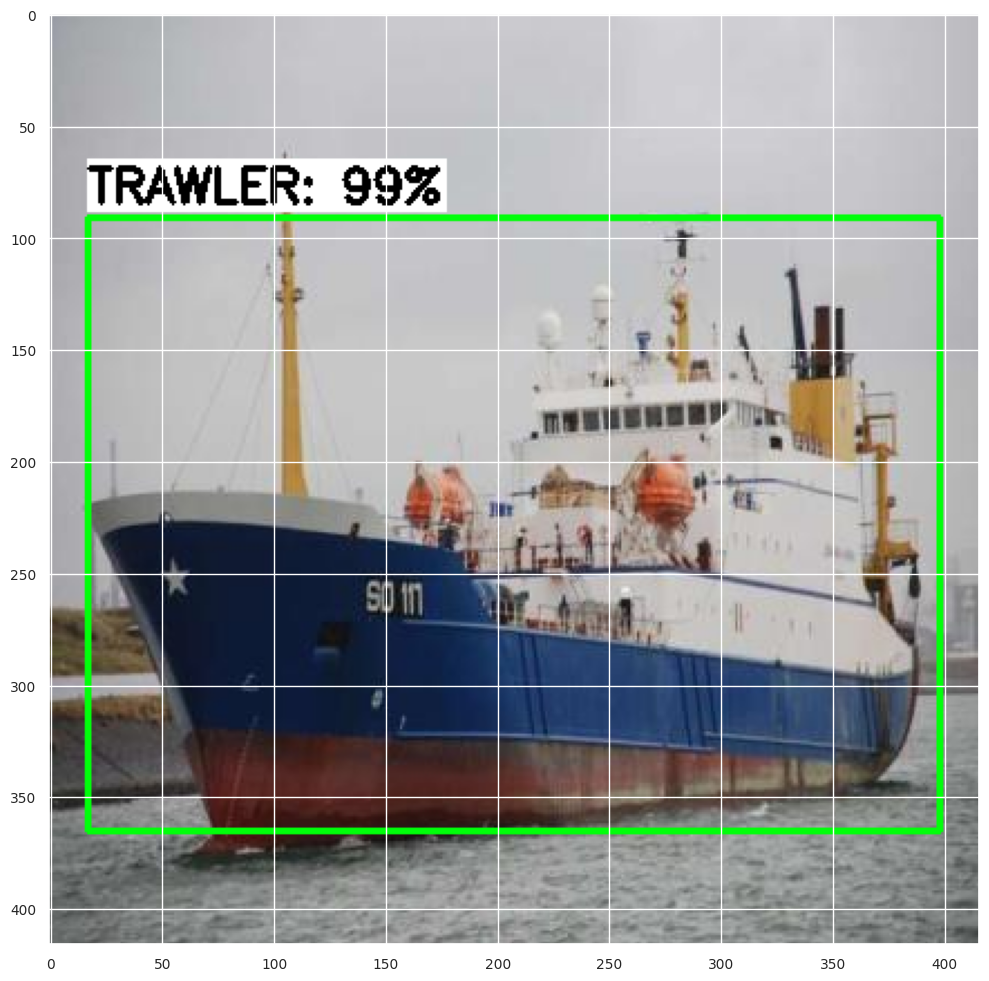

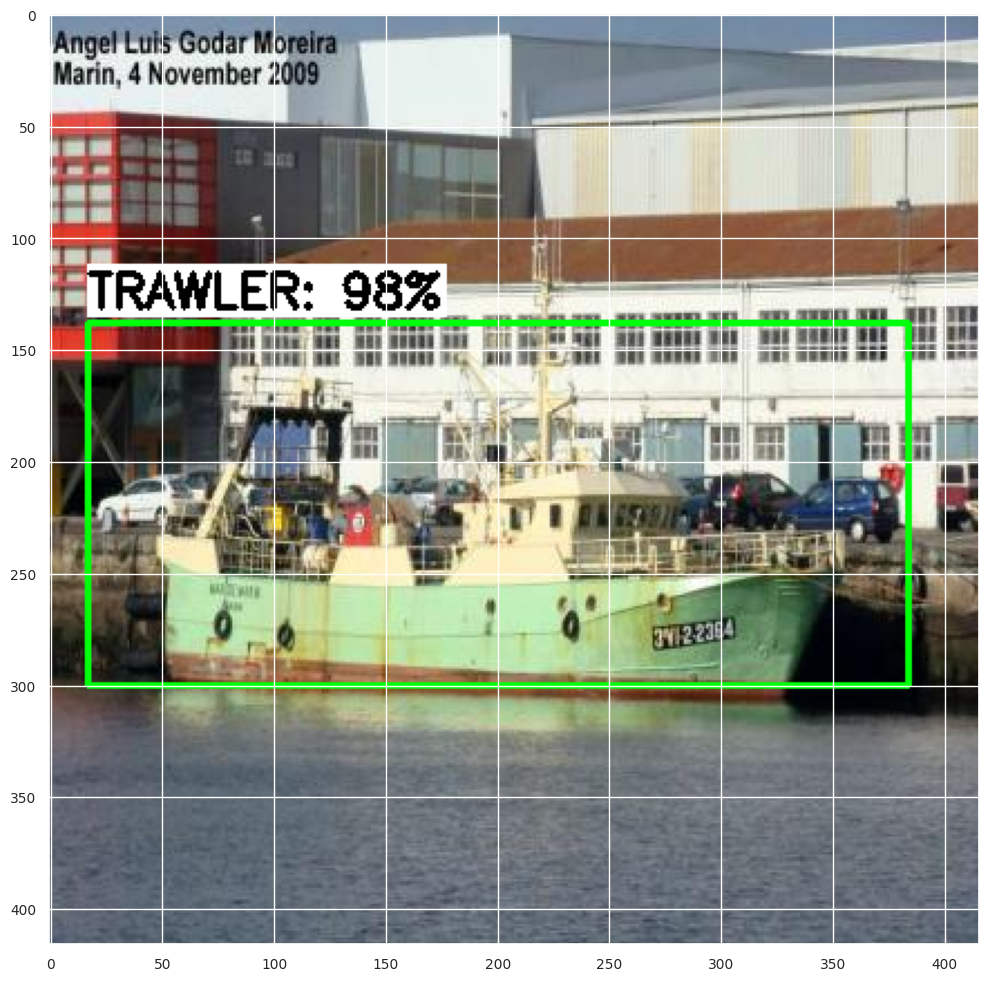

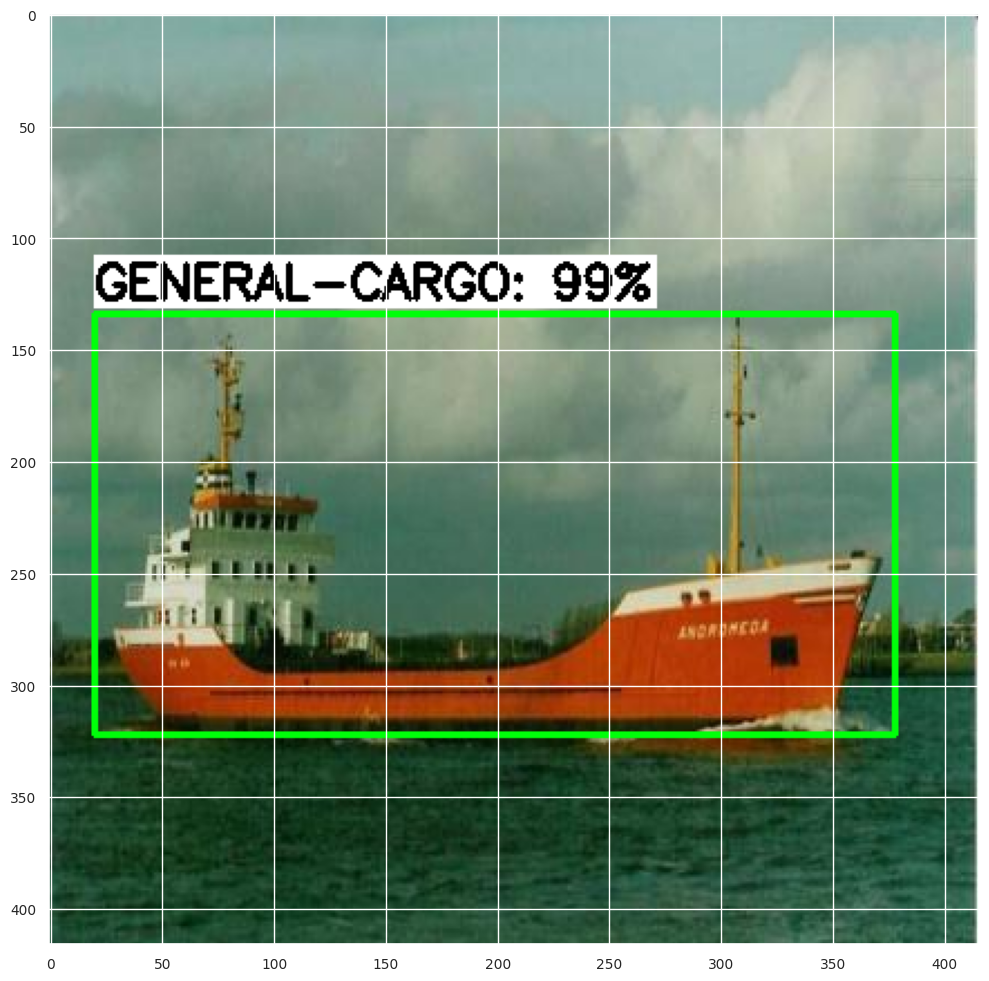

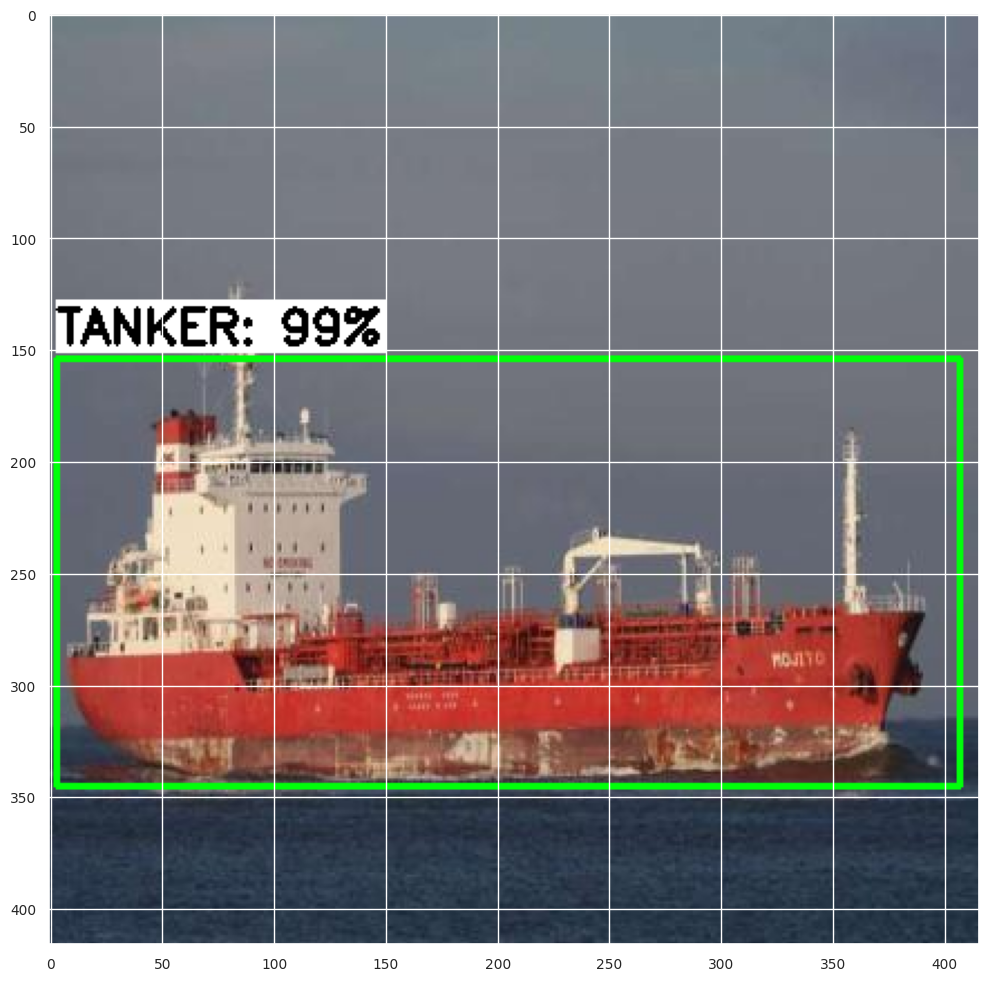

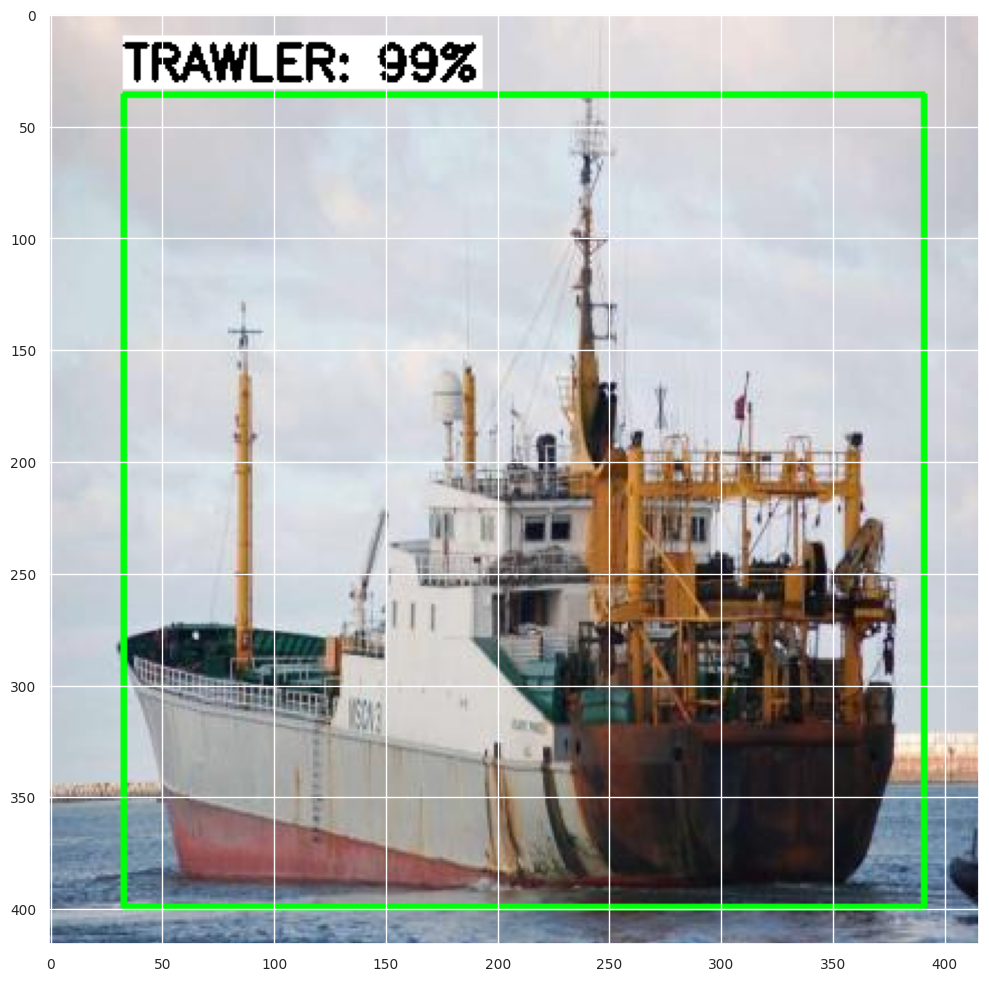

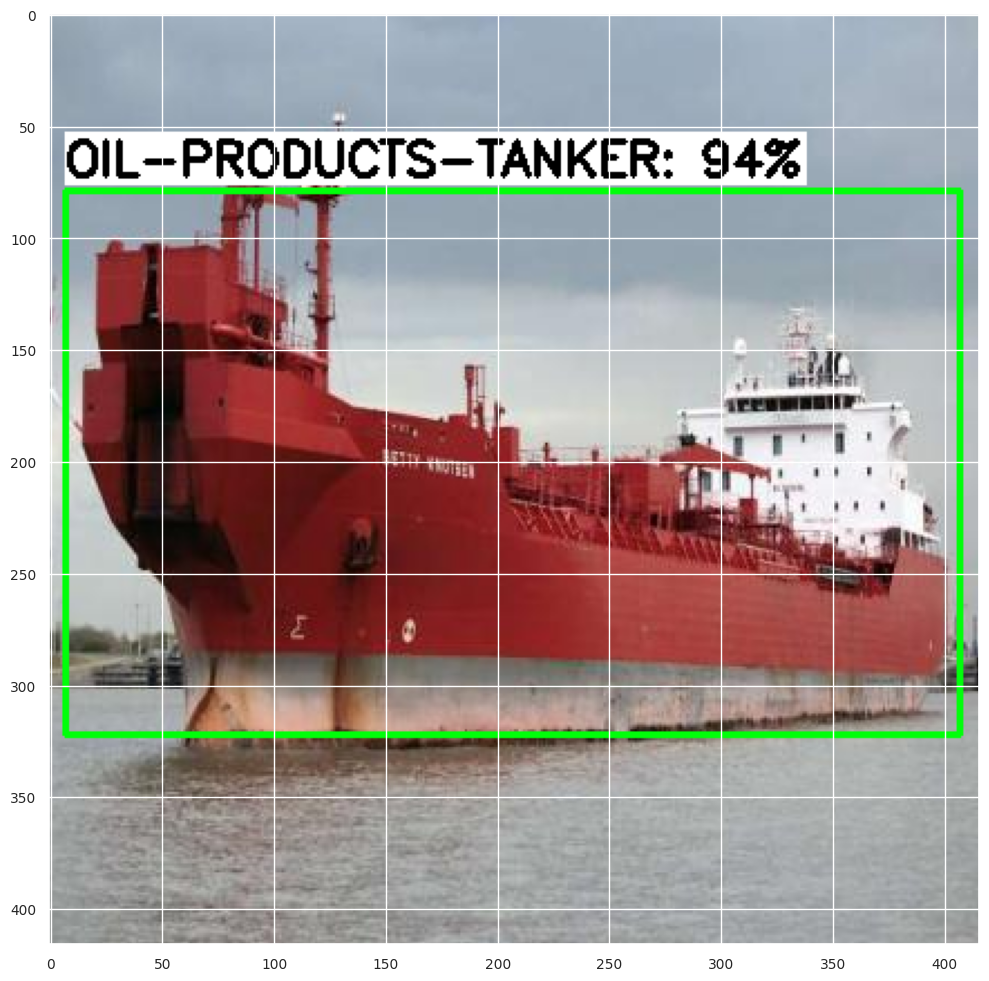

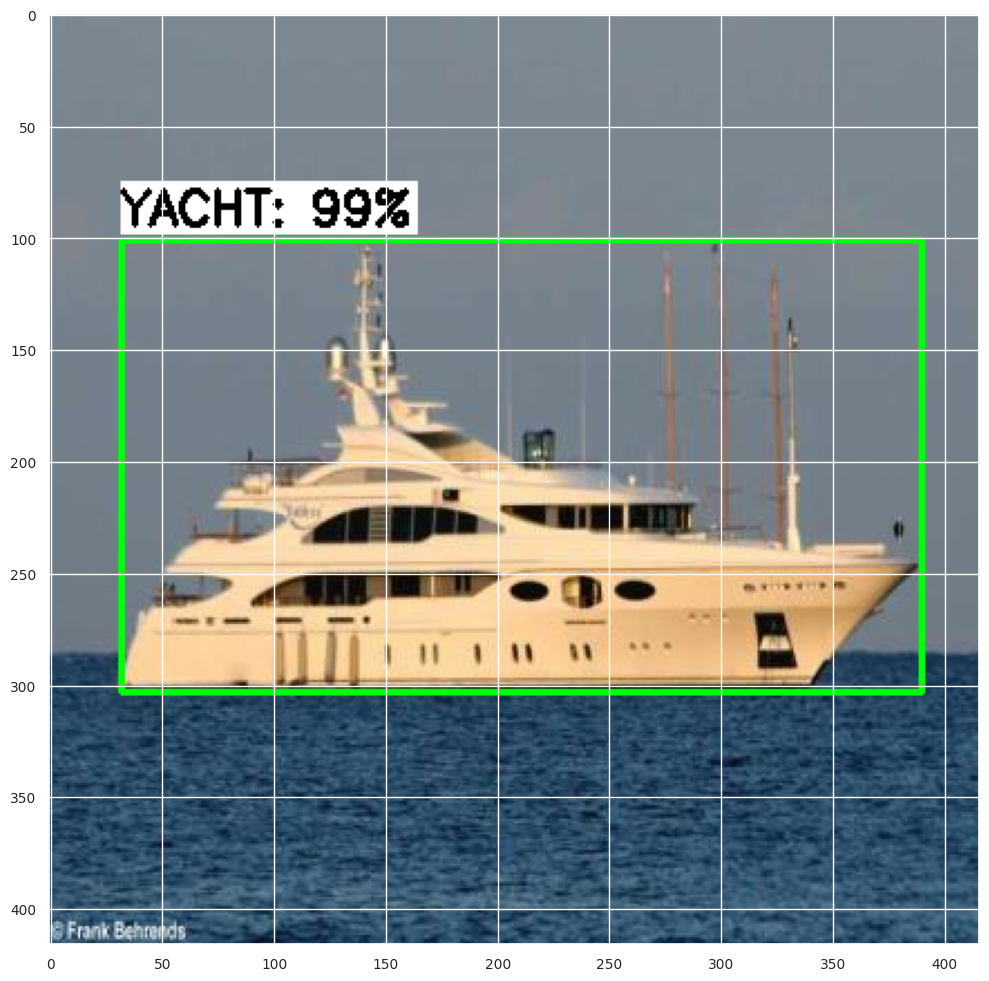

In [ ]:

PATH_TO_IMAGES='/content/images/test'   
PATH_TO_MODEL='/content/ATECH_DEVELOPMENT/MobileNetssdpfpnlite320/custom_model_lite/detect_quant.tflite'   
PATH_TO_LABELS='/content/labelmap.txt'  
min_conf_threshold=0.5  
images_to_test = 10 

tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

Se o seu modelo quantizado não estiver a ter um desempenho muito bom, tente usar o meu notebook TensorFlow Lite 1 *(link a ser adicionado)* para treinar um modelo SSD-MobileNet com o seu conjunto de dados. Na minha experiência, o modelo `ssd-mobilenet-v2-quantized` do [TF1 Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf1_detection_zoo.md) tem o melhor desempenho quantizado de qualquer outro modelo do TensorFlow Lite.
Os modelos TFLite criados com o TensorFlow 1 ainda são compatíveis com o tempo de execução do TensorFlow Lite 2, portanto seu modelo TFLite 1 ainda funcionará com meu [TensorFlow setup guide for the Raspberry Pi](https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/Raspberry_Pi_Guide.md).

 
 


## 9.3 Calcular o mAP do modelo quantizado
Vamos calcular o mAP do modelo quantizado usando a ferramenta de cálculo que configurámos no Passo 7.2. Só precisamos de efetuar a inferência com o nosso modelo quantizado (`detect_quant.tflite`) para obter um novo conjunto de resultados de deteção.
Execute o seguinte bloco para executar a inferência nas imagens de teste e guardar os resultados da deteção.

 
 


In [ ]:
!rm -rf /content/mAP/input/detection-results/

In [ ]:

PATH_TO_IMAGES='/content/images/valid'   
PATH_TO_MODEL='/content/ATECH_DEVELOPMENT/MobileNetssdpfpnlite320/custom_model_lite/detect_quant.tflite' 
PATH_TO_LABELS='/content/labelmap.txt'   
PATH_TO_RESULTS='/content/mAP/input/detection-results'
min_conf_threshold=0.0 

image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(1042, len(image_list)) 

txt_only = True

print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

Starting inference on 1042 images...
Finished inferencing!


Agora podemos executar o script de cálculo do mAP para determinar o mAP do nosso modelo quantizado.

 
 


In [ ]:
%cd /content/mAP

/content/mAP


## renomear outdir outputquantize ou output2

 
 


In [ ]:
!python scripts/extra/intersect-gt-and-dr.py

total ground-truth files: 1042
total detection-results files: 1042

No backup required for /content/mAP/input/ground-truth
No backup required for /content/mAP/input/detection-results
total intersected files: 1042
Intersection completed!


In [ ]:
!cd /content/mAP
!python calculate_map_cartucho.py --labels=/content/labelmap.txt --show_plots --metric='pascalvoc'

Calculating mAP at 0.50 IoU threshold...
74.33% = BULK-CARRIER AP 
88.35% = CONTAINER-SHIP AP 
71.02% = GENERAL-CARGO AP 
50.09% = OIL-PRODUCTS-TANKER AP 
96.63% = PASSENGERS-SHIP AP 
47.13% = TANKER AP 
94.44% = TRAWLER AP 
95.93% = TUG AP 
96.94% = VEHICLES-CARRIER AP 
95.88% = YACHT AP 
mAP = 81.07%
Figure(640x480)

***mAP Results***

Class		Average mAP @ 0.5:0.95
---------------------------------------
BULK-CARRIER		74.33%
CONTAINER-SHIP		88.35%
GENERAL-CARGO		71.02%
OIL-PRODUCTS-TANKER		50.09%
PASSENGERS-SHIP		96.63%
TANKER		47.13%
TRAWLER		94.44%
TUG		95.93%
VEHICLES-CARRIER		96.94%
YACHT		95.88%

Overall		81.07%


## 9.4. Compilar modelo para Edge TPU
Agora que o modelo foi convertido para TFLite e quantizado, podemos compilá-lo para rodar em dispositivos Edge TPU como o [Coral USB Accelerator](https://coral.ai/products/accelerator/) ou o [Coral Dev Board](https://coral.ai/products/dev-board/). Isso permite que o modelo seja executado muito mais rapidamente! Para obter informações sobre como configurar o Acelerador USB, meu [repositório do TensorFlow Lite no GitHub](https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/deploy_guides/Raspberry_Pi_Guide.md#section-2---run-edge-tpu-object-detection-models-on-the-raspberry-pi-using-the-coral-usb-accelerator).
Primeiro, instale o pacote Edge TPU Compiler dentro desta instância do Colab.

 
 


In [ ]:
! curl https://packages.cloud.google.com/apt/doc/apt-key.gpg | sudo apt-key add -
! echo "deb https://packages.cloud.google.com/apt coral-edgetpu-stable main" | sudo tee /etc/apt/sources.list.d/coral-edgetpu.list
! sudo apt-get update
! sudo apt-get install edgetpu-compiler

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  2659  100  2659    0     0  22470      0 --:--:-- --:--:-- --:--:-- 22533
OK
deb https://packages.cloud.google.com/apt coral-edgetpu-stable main
Get:1 file:/var/cuda-repo-ubuntu1804-11-0-local  InRelease
Ign:1 file:/var/cuda-repo-ubuntu1804-11-0-local  InRelease
Get:2 file:/var/cuda-repo-ubuntu1804-11-0-local  Release [564 B]
Get:2 file:/var/cuda-repo-ubuntu1804-11-0-local  Release [564 B]
Hit:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:6 https://packages.cloud.google.com/apt coral-edgetpu-stable InRelease [6,332 B]
Get:7 http://security.ubuntu.com/ubuntu jammy-security InRelease [110 kB]
Hit:8 http://archive.ubuntu.com/ubuntu

Em seguida, compile o modelo TFLite de quantização. (Se o seu modelo tiver um nome de ficheiro diferente de "detect_quant.tflite", utilize-o).

In [ ]:
%cd /content/custom_model_lite
!edgetpu_compiler detect_quant.tflite
!mv detect_quant_edgetpu.tflite edgetpu.tflite
!rm detect_quant_edgetpu.log

/content/custom_model_lite
Edge TPU Compiler version 16.0.384591198
Started a compilation timeout timer of 180 seconds.

Model compiled successfully in 1611 ms.

Input model: detect_quant.tflite
Input size: 3.58MiB
Output model: detect_quant_edgetpu.tflite
Output size: 3.94MiB
On-chip memory used for caching model parameters: 3.23MiB
On-chip memory remaining for caching model parameters: 4.37MiB
Off-chip memory used for streaming uncached model parameters: 0.00B
Number of Edge TPU subgraphs: 1
Total number of operations: 160
Operation log: detect_quant_edgetpu.log

Model successfully compiled but not all operations are supported by the Edge TPU. A percentage of the model will instead run on the CPU, which is slower. If possible, consider updating your model to use only operations supported by the Edge TPU. For details, visit g.co/coral/model-reqs.
Number of operations that will run on Edge TPU: 112
Number of operations that will run on CPU: 48
See the operation log file for individual 

O modelo compilado será enviado para a pasta `custom_model_lite` como "detect__quant_edgetpu.tflite". Ele é renomeado para "edgetpu.tflite" para ser consistente com o meu código. Compacte a pasta `custom_model_lite` e baixe-a executando os dois blocos de código abaixo.

In [ ]:
%cd /content
!zip -r custom_model_lite.zip custom_model_lite

/content
updating: custom_model_lite/ (stored 0%)
updating: custom_model_lite/detect.tflite (deflated 9%)
updating: custom_model_lite/labelmap.pbtxt (deflated 61%)
updating: custom_model_lite/pipeline_file.config (deflated 65%)
updating: custom_model_lite/saved_model/ (stored 0%)
updating: custom_model_lite/saved_model/saved_model.pb (deflated 91%)
updating: custom_model_lite/saved_model/assets/ (stored 0%)
updating: custom_model_lite/saved_model/variables/ (stored 0%)
updating: custom_model_lite/saved_model/variables/variables.data-00000-of-00001 (deflated 9%)
updating: custom_model_lite/saved_model/variables/variables.index (deflated 78%)
updating: custom_model_lite/labelmap.txt (deflated 20%)
  adding: custom_model_lite/detect_quant.tflite (deflated 30%)
  adding: custom_model_lite/edgetpu.tflite (deflated 29%)


In [ ]:
from google.colab import files

files.download('custom_model_lite.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Verificando tamanho do modelo

In [ ]:
def get_file_size(file_path):
  size = os.path.getsize(file_path)
  return size
def convert_bytes(size, unit=None):
  if unit == 'KB':
    return print('File size: ', str(round(size/1024,3)), ' Kilobytes')
  elif unit == 'MB':
    return print('File size: ', str(round(size/(1024 * 1024),3)) , ' Megaobytes')
  else:
    return print('File size: ', str(size), 'Bytes')

In [ ]:
import os
file_ = '/content/ATECH_DEVELOPMENT/MobileNetssdpfpnlite320/custom_model_lite/detect.tflite'
convert_bytes(get_file_size(file_), 'MB')

File size:  10.991  Megaobytes


In [ ]:
import os
file_ = '/content/ATECH_DEVELOPMENT/MobileNetssdpfpnlite320/custom_model_lite/detect_quant.tflite'
convert_bytes(get_file_size(file_), 'MB')

File size:  3.579  Megaobytes


Agora está tudo pronto para usar o modelo Coral! Para obter instruções sobre como executar um modelo de deteção de objectos no Raspberry Pi utilizando o acelerador Coral USB, consulte o meu vídeo, ["How to Use the Coral USB Accelerator with the Raspberry Pi"](https://www.youtube.com/watch?v=qJMwNHQNOVU).